# **ELIXIR Spatial Transcriptomics Course**

Author: George Gavriilidis

Date: 2025-02-22

Author email: ggeorav@certh.gr

# Practical 2: Sequence-based data analysis

### Quiz: Pre-Workshop Check


1. How can `SpatialData` enable interoperability between tools like Scanpy and Squidpy?  

2. What are the main advantages of using `SpatialData` objects over plain tables or data frames for spatial transcriptomics data?  

3. Why is it important to integrate high-resolution images with gene expression data in spatial analyses?  

4. Describe one use case where combining `SpatialData` with `Scanpy` and `Squidpy` could enhance your analysis.  

5. What types of visualizations can be generated using `Squidpy` that are not typically available in `Scanpy` alone?

6. What are some advanced visualisations that `SpatialData` can facilitate for sequence-based analysis?

Take a moment to reflect on these questions before moving on to the hands-on exercises.


## Dependencies

In [ ]:
# !pip install 'squidpy[interactive]'

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.8/87.8 kB 4.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
INFO: pip is looking at multiple versions of spatialdata to determine which version is compatible with other requirements. This could take a while.
  Preparing metadata (setup.py) ... done
INFO: pip is looking at multiple versions of dask-expr to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of distributed to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of s3fs to determine which version is compatible with other requirements. This could take a while.
INFO: pip is still looking at multiple versions of s3fs to determine which version is compatible with other requirements. This could take a while.
INFO: This is taking longe

In [ ]:
# !pip install fsspec==2024.10.0 gcsfs==2024.10.0

In [1]:
from spatialdata_io import visium, visium_hd, xenium

/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/numba/core/decorators.py:246: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)


In [2]:
data_path = "./data/"

In [ ]:
import spatialdata as sd
import spatialdata_plot as sdp
from spatialdata_io import visium, visium_hd, xenium
import matplotlib.pyplot as plt  # for multi-panel plots later

## Deploying `Scanpy` for spatial analysis on Visium

In [1]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
sc.settings.verbosity = 3

In [ ]:
# import os

# # Define the folder path you want to create
# folder_path = "./data/visium_coronal/"

# # Create the folder path
# try:
#     os.makedirs(folder_path, exist_ok=True)
#     print(f"Folder path '{folder_path}' created successfully.")
# except Exception as e:
#     print(f"An error occurred while creating the folder path: {e}")

In [ ]:
# # Download the .h5 file
# !wget -O ./data/visium_coronal/V1_Adult_Mouse_Brain_raw_feature_bc_matrix.h5 \
# https://cf.10xgenomics.com/samples/spatial-exp/1.1.0/V1_Adult_Mouse_Brain/V1_Adult_Mouse_Brain_raw_feature_bc_matrix.h5

# # Download the spatial.tar.gz file
# !wget -O ./data/visium_coronal/V1_Adult_Mouse_Brain_spatial.tar.gz \
# https://cf.10xgenomics.com/samples/spatial-exp/1.1.0/V1_Adult_Mouse_Brain/V1_Adult_Mouse_Brain_spatial.tar.gz

In [ ]:
# import tarfile
# import os

# # Define the file paths
# tar_file_path = "./data/visium_coronal/V1_Adult_Mouse_Brain_spatial.tar.gz"
# extract_path = "./data/visium_coronal/"

# # Extract the tar.gz file
# try:
#     with tarfile.open(tar_file_path, "r:gz") as tar:
#         tar.extractall(path=extract_path)
#     print(f"Extracted files to: {extract_path}")
#     print("Contents:", os.listdir(extract_path))
# except Exception as e:
#     print(f"An error occurred while extracting the file: {e}")

In [79]:
import scanpy as sc

# Define the path to the organized Visium data directory
visium_data_path = './data/visium_coronal/'

# Read the Visium data into an AnnData object
adata = sc.read_visium(visium_data_path, count_file="V1_Adult_Mouse_Brain_raw_feature_bc_matrix.h5")

# Display basic information about the AnnData object
print(adata)

reading data/visium_coronal/V1_Adult_Mouse_Brain_raw_feature_bc_matrix.h5
 (0:00:00)
AnnData object with n_obs × n_vars = 4992 × 32285
    obs: 'in_tissue', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'


/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1756: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1756: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [70]:
adata

AnnData object with n_obs × n_vars = 4992 × 32285
    obs: 'in_tissue', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

### Quality Control (QC)

We perform some basic filtering of spots based on total counts and expressed genes

In [81]:
adata.var_names_make_unique()
adata.var["mt"] = adata.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True)

<Axes: xlabel='n_genes_by_counts', ylabel='Count'>

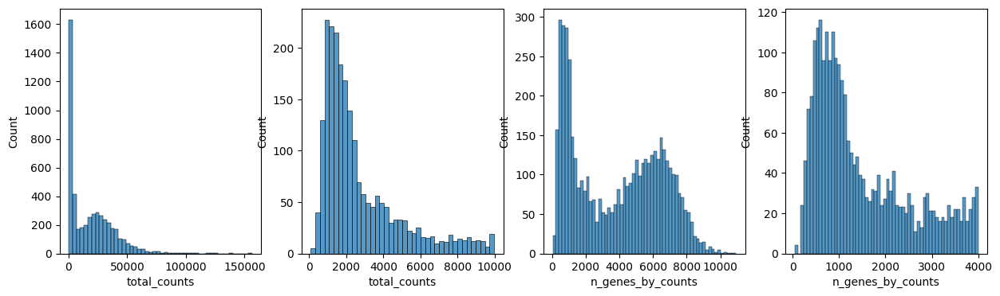

In [12]:
fig, axs = plt.subplots(1, 4, figsize=(15, 4))
sns.histplot(adata.obs["total_counts"], kde=False, ax=axs[0])
sns.histplot(
    adata.obs["total_counts"][adata.obs["total_counts"] < 10000],
    kde=False,
    bins=40,
    ax=axs[1],
)
sns.histplot(adata.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[2])
sns.histplot(
    adata.obs["n_genes_by_counts"][adata.obs["n_genes_by_counts"] < 4000],
    kde=False,
    bins=60,
    ax=axs[3],
)

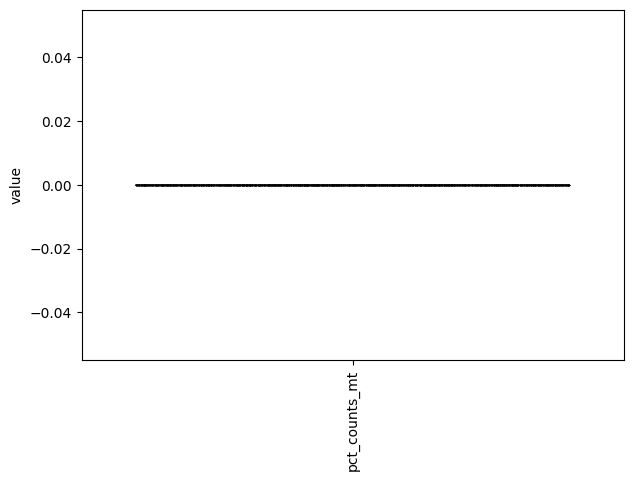

In [13]:
sc.pl.violin(adata, ['pct_counts_mt'], jitter=0.4, groupby=None, rotation=90)

Outlier Detection: Identify cells with unusually high or low:

*   total counts
*   gene counts

that often represent technical artifacts.


Zooming In: Filtering thresholds (<10,000 for counts, <4,000 for genes) help focus on the majority of cells without outliers dominating the view.


Quality Control:
Cells with low total_counts or n_genes_by_counts may represent:\
*   Poor sequencing quality
*   Empty or dying cells

In [ ]:
adata

AnnData object with n_obs × n_vars = 4035 × 36601
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial'
    obsm: 'spatial'

<div style="border: 1px solid #ffa6a6; padding: 10px; border-radius: 5px;">
<span style="color: #ff6666; font-size: 20px;"><b>Reflection Point:</b></span> <span style="font-size: 20px;">Spatial QC Visualization</span>  
<ul>
    <li>Plot the spatial distribution of total counts, number of genes, and mitochondrial percentage.</li>
</ul>
<p>Reflect on the following:</p>
<ol>
    <li>Are there regions with consistently high or low QC metrics?</li>
    <li>How might this influence your filtering decisions?</li>
    <li>If you want to analyze mitochondrial and bioenergetics activity in spatial data, how would you compensate for mitochondrial filtering?</li>
</ol>
</div>

In [44]:
from IPython.display import display, HTML

# Define the reflection question with green styling
reflection_question = """
<div style="border: 1px solid #90ee90; padding: 10px; border-radius: 5px;">
<span style="color: #32cd32; font-size: 16px;"><b>Some thoughts on mitochondria and bioenergetic analyses:</b></span>
</div>
"""

# Define the hidden answer with collapsible content
hidden_answer = """
<details>
<summary>Click to reveal the answer</summary>
<p>
To analyze mitochondrial and bioenergetic activity, you can compensate for mitochondrial filtering by:
<ul>
    <li><b>Adjusting Thresholds:</b> Use higher thresholds for mitochondrial gene percentage (e.g., 30%) or avoid filtering by mitochondrial content entirely.</li>
    <li><b>Focusing on Mitochondrial Genes:</b> Analyze mitochondrial genes separately to study bioenergetic activity while applying QC on non-mitochondrial genes.</li>
    <li><b>Localized Filtering:</b> Retain regions with high mitochondrial content where bioenergetic activity is biologically relevant, and filter based on other QC metrics (e.g., total counts).</li>
    <li><b>Spatial Context:</b> Use spatial neighborhood analyses (e.g., with Squidpy) to understand how regions with high mitochondrial activity interact with surrounding spots.</li>
</ul>
Visualizing mitochondrial content spatially helps identify patterns, such as biologically active regions, cell stress zones, or edge artifacts, ensuring meaningful analysis.
</p>
</details>
"""

# Display the reflection question with hidden answer
display(HTML(reflection_question + hidden_answer))

In [82]:
# Filter cells with at least 2000 counts and at most 40,000 counts
sc.pp.filter_cells(adata, min_counts=2000)
sc.pp.filter_cells(adata, max_counts=40000)

# Filter cells with at least 500 genes detected
sc.pp.filter_cells(adata, min_genes=500)

# Filter cells with less than 20% mitochondrial counts
adata = adata[adata.obs["pct_counts_mt"] < 20].copy()

# Filter genes expressed in at least 10 cells
sc.pp.filter_genes(adata, min_cells=10)

# Display filtered cell count
print(f"#cells after filtering: {adata.n_obs}")

filtered out 15410 genes that are detected in less than 10 cells
#cells after filtering: 3204


In [26]:
adata

AnnData object with n_obs × n_vars = 3204 × 16875
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'zscore_total_counts', 'n_counts', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial'

We proceed to normalize Visium counts data with the built-in normalize_total method from Scanpy, and detect highly-variable genes (for later).

In [83]:
sc.pp.normalize_total(adata, inplace=True)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, flavor="seurat", n_top_genes=2000)

normalizing counts per cell
    finished (0:00:00)


<div style="border: 1px solid #ffa6a6; padding: 10px; border-radius: 5px;">
<span style="color: #ff6666; font-size: 20px;"><b>Reflection Point:</b></span> <span style="font-size: 20px;">Methods for Highly Variable Genes (HVGs)</span>  
<ul>
    <li>What other methods can we use for highly variable genes?</li>
</ul>
</div>

In [99]:
from IPython.display import display, HTML

# Define the reflection question with brighter green styling and smaller font size
reflection_question = """
<div style="border: 1px solid #90ee90; padding: 10px; border-radius: 5px;">
<span style="color: #32cd32; font-size: 16px;"><b>Other pertinent methods for HVGs:</b></span>
</div>
"""

# Define the hidden answer with collapsible content
hidden_answer = """
<details>
<summary>Click to reveal the answer</summary>
<p>
For identifying highly variable genes in spatial omics data, the choice of flavor depends on the dataset's characteristics:
<ul>
    <li><b>`cell_ranger`</b>: Best for spatial datasets processed with 10X Genomics tools like Visium. It uses variance on log-transformed values, making it effective for datasets with a wide dynamic range.</li>
    <li><b>`seurat` or `seurat_v3`</b>: Useful for datasets with batch effects or uneven sequencing depths, balancing variability across conditions or regions.</li>
    <li><b>`pearson_residuals`</b>: Ideal for sparse datasets (e.g., UMI-based data with low gene detection per spot) as it models overdispersion using a negative binomial regression.</li>
</ul>

<b>Spatially Variable Genes</b>:
<ul>
    <li>Spatially variable genes show distinct expression patterns that are spatially organized, highlighting biologically meaningful regions (e.g., tissue boundaries, specialized zones).</li>
    <li>These genes can be identified using tools like <b>Squidpy</b> (e.g., Moran's I for spatial autocorrelation).</li>
    <li>Unlike general highly variable genes, spatially variable genes capture spatial context, making them more informative for understanding tissue organization and function.</li>
</ul>

For spatial omics analysis:
<ul>
    <li>Start with <b>`cell_ranger`</b> for general highly variable gene detection.</li>
    <li>Use <b>spatial variability analysis</b> (e.g., Moran's I, Geary's C) to focus on genes with meaningful spatial patterns.</li>
</ul>
</p>
</details>
"""

# Display the reflection question with hidden answer
display(HTML(reflection_question + hidden_answer))


### Manifold embedding and clustering based on transcriptional similarity

To embed and cluster the manifold encoded by transcriptional similarity, we proceed as in the standard clustering tutorial.

In [28]:
sc.pp.pca(adata)
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.leiden(
    adata, key_added="clusters", flavor="igraph", directed=False, n_iterations=2
)

computing PCA
    with n_comps=50
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:02)
running Leiden clustering
    finished: found 16 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:00)


We plot some covariates to check if there is any particular structure in the UMAP associated with total counts and detected genes.

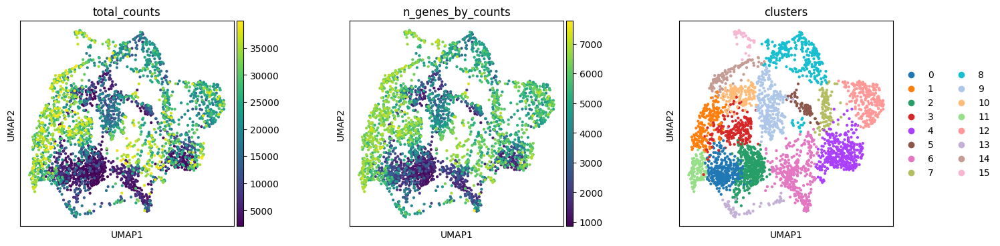

In [29]:
plt.rcParams["figure.figsize"] = (4, 4)
sc.pl.umap(adata, color=["total_counts", "n_genes_by_counts", "clusters"], wspace=0.4)

### Visualization in spatial coordinates

Let us now take a look at how total_counts and n_genes_by_counts behave in spatial coordinates. We will overlay the circular spots on top of the Hematoxylin and eosin stain (H&E) image provided, using the function sc.pl.spatial.

In [30]:
adata

AnnData object with n_obs × n_vars = 3204 × 16875
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'zscore_total_counts', 'n_counts', 'n_genes', 'clusters'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'spatial', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'clusters', 'clusters_colors'
    obsm: 'spatial', 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

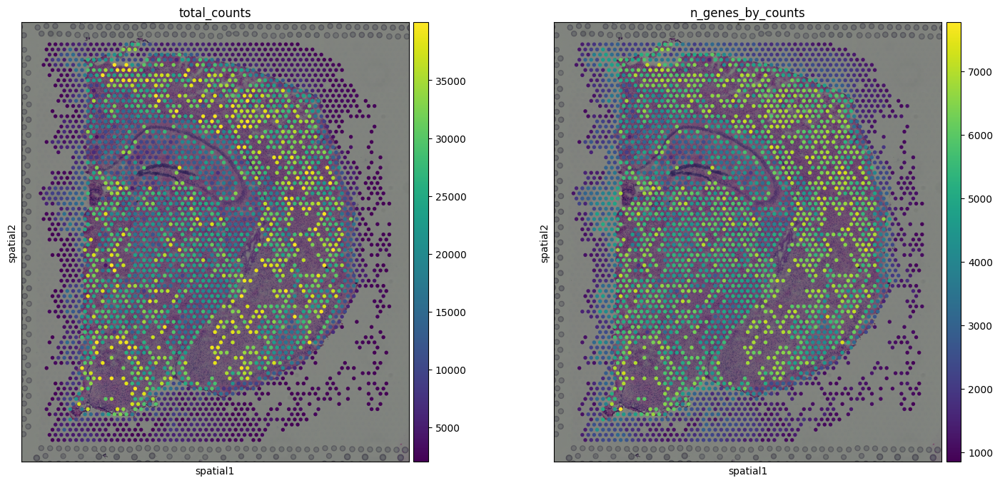

In [31]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(adata, img_key="hires", color=["total_counts", "n_genes_by_counts"])

The function sc.pl.spatial accepts 4 additional parameters:

-img_key: key where the img is stored in the adata.uns element

-crop_coord: coordinates to use for cropping (left, right, top, bottom)

-alpha_img: alpha value for the transcparency of the image

-bw: flag to convert the image into gray scale

Furthermore, in sc.pl.spatial, the size parameter changes its behaviour: it becomes a scaling factor for the spot sizes.

Before, we performed clustering in gene expression space, and visualized the results with UMAP. By visualizing clustered samples in spatial dimensions, we can gain insights into tissue organization and, potentially, into inter-cellular communication.

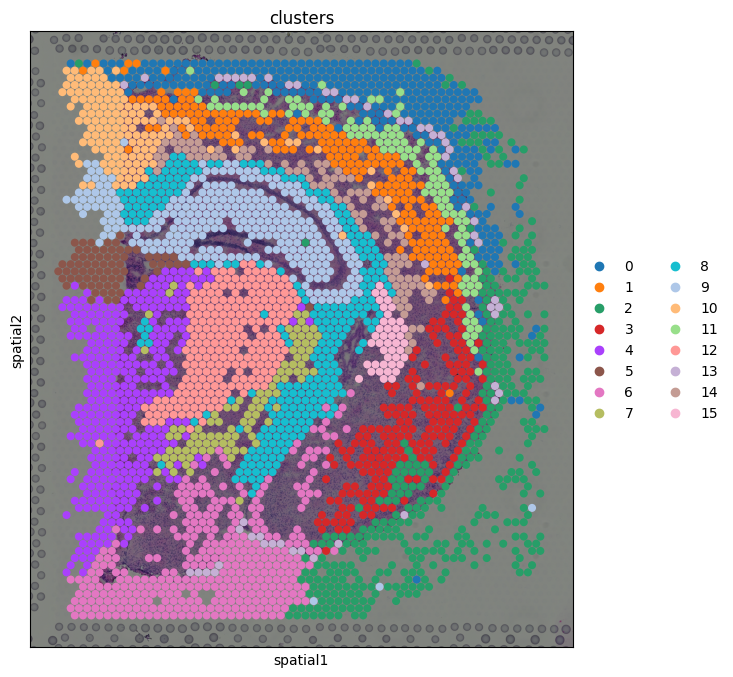

In [32]:
sc.pl.spatial(adata, img_key="hires", color="clusters", size=1.5)

Spots belonging to the same cluster in gene expression space often co-occur in spatial dimensions. For instance, spots belonging to cluster 5 are often surrounded by spots belonging to cluster 0.

We can zoom in specific regions of interests to gain qualitative insights. Furthermore, by changing the alpha values of the spots, we can visualize better the underlying tissue morphology from the H&E image.

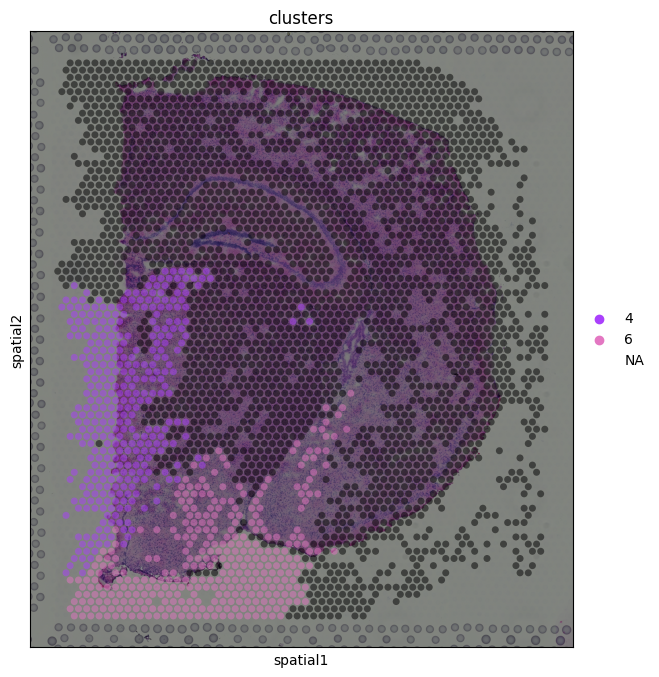

In [34]:
sc.pl.spatial(
    adata,
    img_key="hires",
    color="clusters",
    groups=["4", "6"],
    #crop_coord=[7000, 10000, 0, 6000],
    alpha=0.5,
    size=1.3,
)

### Cluster Marker genes

Let us further inspect cluster 5, which occurs in small groups of spots across the image.

Compute marker genes and plot a heatmap with expression levels of its top 10 marker genes across clusters.

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


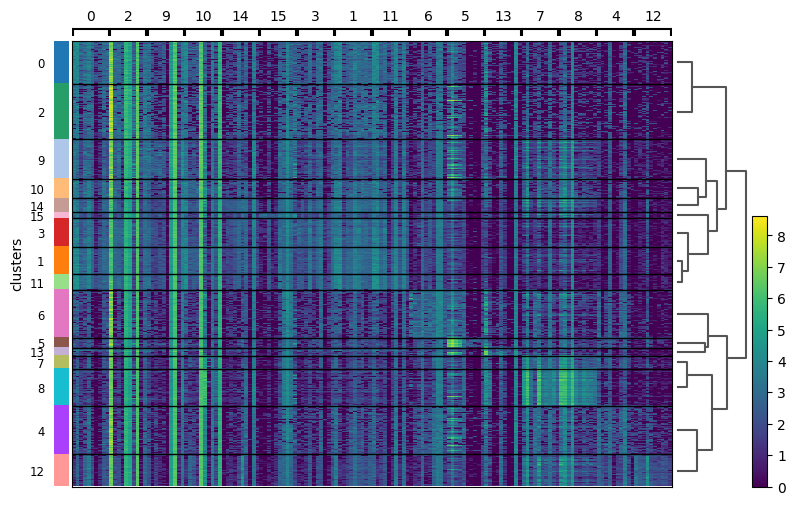

In [41]:
sc.tl.rank_genes_groups(adata, "clusters", method="t-test")
sc.pl.rank_genes_groups_heatmap(adata, n_genes=10, groupby="clusters")

In [44]:
# Extract log fold-changes and adjusted p-values
cluster_8_logfoldchanges = adata.uns['rank_genes_groups']['logfoldchanges']['8']
cluster_8_pvals_adj = adata.uns['rank_genes_groups']['pvals_adj']['8']

# Combine into a DataFrame for easier viewing
import pandas as pd

cluster_8_df = pd.DataFrame({
    'genes': cluster_8_genes,
    'logfoldchange': cluster_8_logfoldchanges,
    'pvals_adj': cluster_8_pvals_adj
})
print(cluster_8_df)


top_10_genes_cluster_8 = cluster_8_df.head(10)
print(top_10_genes_cluster_8)

        genes  logfoldchange      pvals_adj
0        Plp1       4.494549  3.822667e-255
1         Mbp       3.614367  3.815521e-254
2        Mobp       4.051862  8.483103e-263
3        Fth1       2.367223  4.996332e-204
4         Mal       4.212404  3.280730e-231
...       ...            ...            ...
16870  Eef1a2      -1.659921   1.105588e-74
16871  Pcsk1n      -0.971988   1.635992e-76
16872   Nptxr      -2.203007   5.612369e-87
16873    Thy1      -1.774512   1.008640e-78
16874   Calm1      -1.036551   1.754892e-89

[16875 rows x 3 columns]
   genes  logfoldchange      pvals_adj
0   Plp1       4.494549  3.822667e-255
1    Mbp       3.614367  3.815521e-254
2   Mobp       4.051862  8.483103e-263
3   Fth1       2.367223  4.996332e-204
4    Mal       4.212404  3.280730e-231
5  Cryab       3.529048  2.364124e-237
6    Cnp       3.798829  4.300943e-235
7    Trf       3.843639  2.993938e-218
8    Mag       4.044044  6.863869e-202
9   Qdpr       3.223752  2.340648e-219


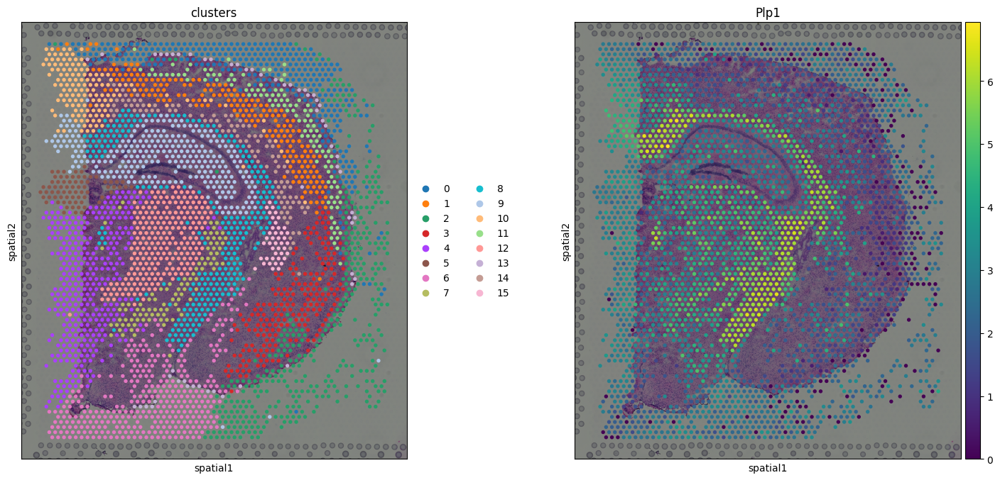

In [45]:
sc.pl.spatial(adata, img_key="hires", color=["clusters", "Plp1"])

In [ ]:
# Plp1 = Myelin Proteolipid Protein

In [47]:
top_10_genes_cluster_8

,genes,logfoldchange,pvals_adj
0,Plp1,4.494549,3.822667e-255
1,Mbp,3.614367,3.815521e-254
2,Mobp,4.051862,8.483103e-263
3,Fth1,2.367223,4.996332e-204
4,Mal,4.212404,3.280730e-231
5,Cryab,3.529048,2.364124e-237
6,Cnp,3.798829,4.300943e-235
7,Trf,3.843639,2.993938e-218
8,Mag,4.044044,6.863869e-202
9,Qdpr,3.223752,2.340648e-219


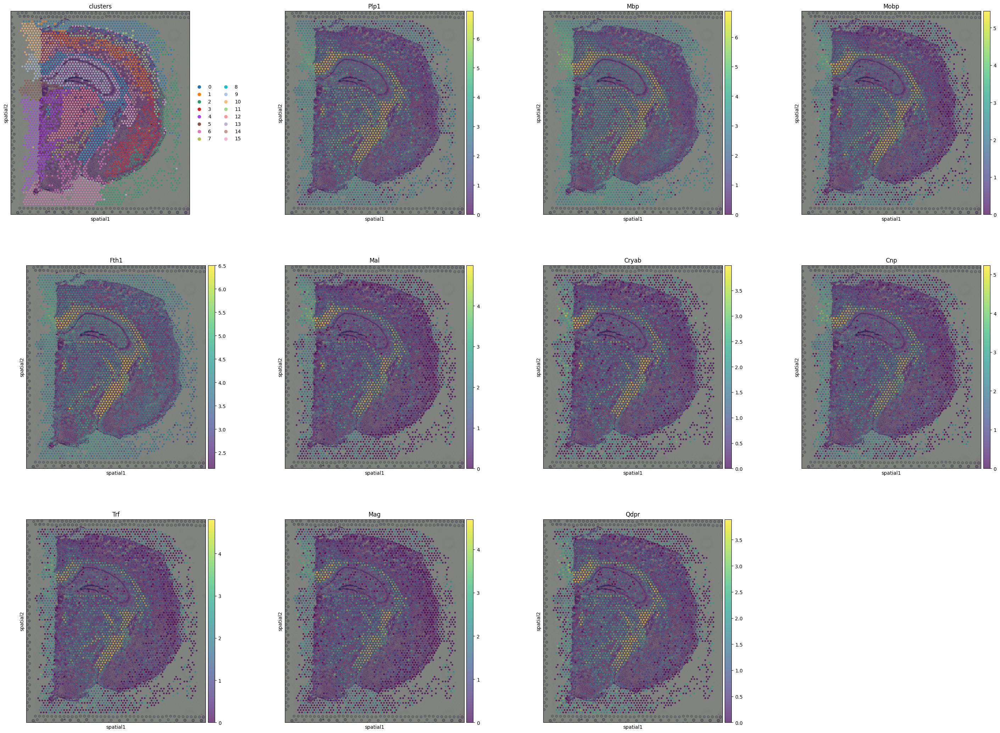

In [52]:
sc.pl.spatial(adata, img_key="hires", color= ["clusters"] + top_10_genes_cluster_8['genes'].tolist(), alpha=0.7)

In [84]:
sc.pp.scale(adata)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [74]:
s_genes_seurat = [
    "Mcm5", "Pcna", "Tyms", "Fen1", "Mcm2", "Mcm4", "Rrm1", "Ung",
    "Gins2", "Mcm6", "Cdca7", "Dtl", "Prim1", "Uhrf1", "Cenpu",
    "Hells", "Rfc2", "Rpa2", "Nasp", "Rad51", "Exo1", "Atad2",
    "Cdc45", "Cdc6", "Tipin", "Blm", "Casp8ap2", "Ubr7", "Pold3",
    "Msh2", "Rad51ap1", "Gmnn", "Wdr76", "Slbp", "Ccne2", "Ube2s",
    "Brca1", "E2f8"
]


g2m_genes_seurat = [
    "Hmgb2", "Cdk1", "Nusap1", "Ube2c", "Birc5", "Tpx2", "Top2a",
    "Mki67", "Cenpf", "Cdc20", "Ttk", "Cenpe", "Aurkb", "Pimreg",
    "Anp32e", "Tubb4b", "Cdca3", "Cdca8", "Ect2", "Kif20b", "Hjurp",
    "Prc1", "Anln", "Kif2c", "Kif23", "Kif11", "Kif4", "Cdca5",
    "Cdc25c", "Kif18b", "Kif22", "Kifc1"
]

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    526 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    589 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


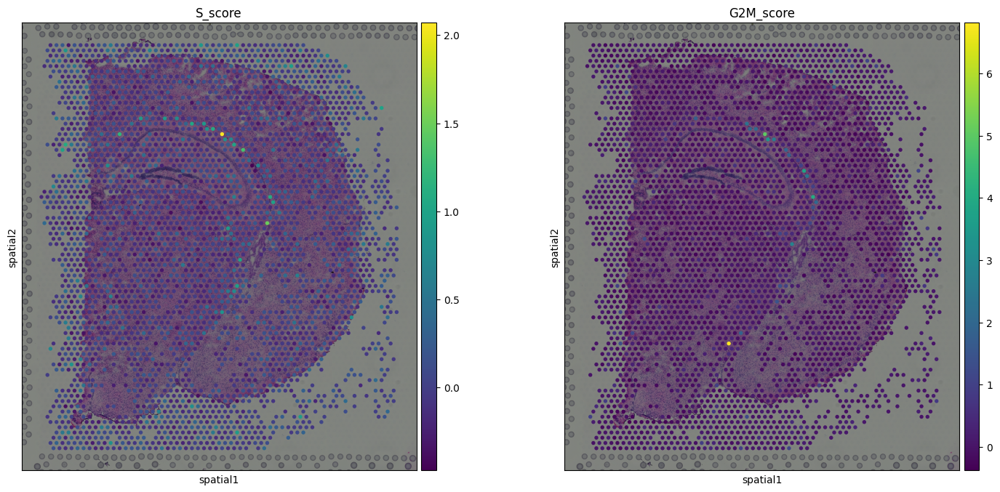

In [85]:
# Score cell cycle phases
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes_mouse, g2m_genes=g2m_genes_mouse)

# Visualize the scores
sc.pl.spatial(adata, color=["S_score", "G2M_score"])

<div style="border: 1px solid #ffa6a6; padding: 10px; border-radius: 5px;">
<span style="color: #ff6666; font-size: 20px;"><b>Reflection Point:</b></span> <span style="font-size: 20px;">Cell cycle regression</span>  
<ul>
    <li>When to regress out cell cycle genes and when not?</li>
</ul>
</div>

In [103]:
from IPython.display import display, HTML

# Define the reflection question with green styling
reflection_question = """
<div style="border: 1px solid #90ee90; padding: 10px; border-radius: 5px;">
<span style="color: #32cd32; font-size: 16px;"><b>Thoughts on cell cycle:</b></span>
</div>
"""

# Define the hidden answer with collapsible content
hidden_answer = """
<details>
<summary>Click to reveal the answer</summary>
<p>
Understanding cell cycle dynamics in spatial transcriptomics is crucial because:
<ul>
    <li>It highlights regions of proliferation (e.g., neural progenitor zones in the brain).</li>
    <li>It can reveal tissue-specific processes such as gliogenesis or tumor growth.</li>
    <li>Cell cycle activity might dominate variability in datasets, overshadowing other biological processes.</li>
</ul>

However, regressing out cell cycle effects has trade-offs:
<ul>
    <li><b>When to regress:</b> If your focus is on non-proliferative processes (e.g., immune signaling or tissue organization), removing cell cycle effects can reduce noise.</li>
    <li><b>When not to regress:</b> If your goal is to study cell cycle-related phenomena (e.g., neural progenitor activity, tumor dynamics), regressing out cell cycle effects may remove biologically meaningful signals.</li>
</ul>

Ultimately, the decision depends on the biological question and the specific regions of interest in your analysis.
</p>
</details>
"""

# Display the reflection question with hidden answer
display(HTML(reflection_question + hidden_answer))

## Deploying `Squidpy` for spatial analysis on Visium

In [104]:
import numpy as np
import pandas as pd

import anndata as ad
import scanpy as sc
import squidpy as sq

sc.logging.print_header()
print(f"squidpy=={sq.__version__}")

# load the pre-processed dataset
img = sq.datasets.visium_hne_image()
adata = sq.datasets.visium_hne_adata()

/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/numba/core/decorators.py:246: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)


scanpy==1.10.3 anndata==0.10.9 umap==0.5.7 numpy==1.26.4 scipy==1.12.0 pandas==2.2.3 scikit-learn==1.6.0 statsmodels==0.14.4 igraph==0.11.8 pynndescent==0.5.13
squidpy==1.6.1


  0%|          | 0.00/380M [00:00<?, ?B/s]

Adding image layer `image`
try downloading from url
https://ndownloader.figshare.com/files/26098397
... this may take a while but only happens once


  0%|          | 0.00/314M [00:00<?, ?B/s]

First, let’s visualize cluster annotation in spatial context with `squidpy.pl.spatial_scatter()`.

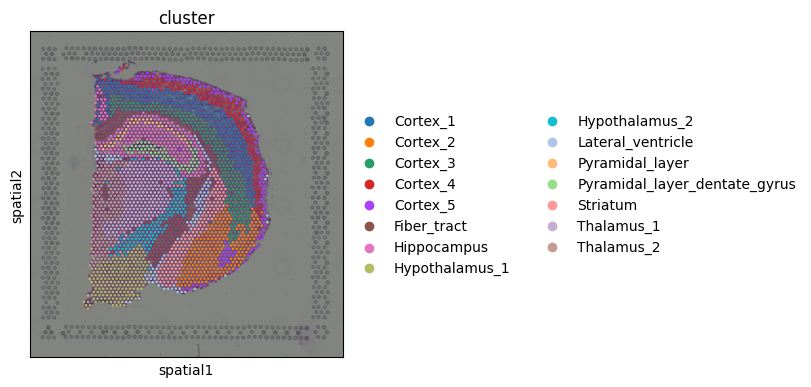

In [105]:
sq.pl.spatial_scatter(adata, color="cluster")

### Image features

Visium datasets contain high-resolution images of the tissue that was used for the gene extraction. Using the function `squidpy.im.calculate_image_features()` you can calculate image features for each Visium spot and create a `obs x features` matrix in `adata` that can then be analyzed together with the `obs x gene` gene expression matrix.

By extracting image features we are aiming to get both similar and complementary information to the gene expression values. Similar information is for example present in the case of a tissue with two different cell types whose morphology is different. Such cell type information is then contained in both the gene expression values and the tissue image features.

Squidpy contains several feature extractors and a flexible pipeline of calculating features of different scales and sizes. There are several detailed examples of how to use `squidpy.im.calculate_image_features()`. Extract image features provides a good starting point for learning more.

Here, we will extract `summary` features at different crop sizes and scales to allow the calculation of multi-scale features and `segmentation` features. For more information on the summary features, also refer to Extract summary features.

In [107]:
# calculate features for different scales (higher value means more context)
for scale in [1.0, 2.0]:
    feature_name = f"features_summary_scale{scale}"
    sq.im.calculate_image_features(
        adata,
        img.compute(),
        features="summary",
        key_added=feature_name,
        n_jobs=4,
        scale=scale,
    )


# combine features in one dataframe
adata.obsm["features"] = pd.concat(
    [adata.obsm[f] for f in adata.obsm.keys() if "features_summary" in f],
    axis="columns",
)
# make sure that we have no duplicated feature names in the combined table
adata.obsm["features"].columns = ad.utils.make_index_unique(
    adata.obsm["features"].columns
)

Calculating features `['summary']` using `4` core(s)


  0%|          | 0/2688 [00:00<?, ?/s]

/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/numba/core/decorators.py:246: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)
/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/numba/core/decorators.py:246: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)
/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/numba/core/decorators.py:246: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)
/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/numba/core/decorators.py:246: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)
/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/numba/core/

Adding `adata.obsm['features_summary_scale1.0']`
Finish (0:00:08)
Calculating features `['summary']` using `4` core(s)


  0%|          | 0/2688 [00:00<?, ?/s]

/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/numba/core/decorators.py:246: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)


Adding `adata.obsm['features_summary_scale2.0']`
Finish (0:00:14)


We can use the extracted image features to compute a new cluster annotation. This could be useful to gain insights in similarities across spots based on image morphology.

computing PCA
    with n_comps=10
    finished (0:00:00)
computing neighbors
    using data matrix X directly
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering


/var/folders/hr/f3msc_bs3z53n3_m4c4ry6tc0000gn/T/ipykernel_1153/3320298302.py:18: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata)


    finished: found 19 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


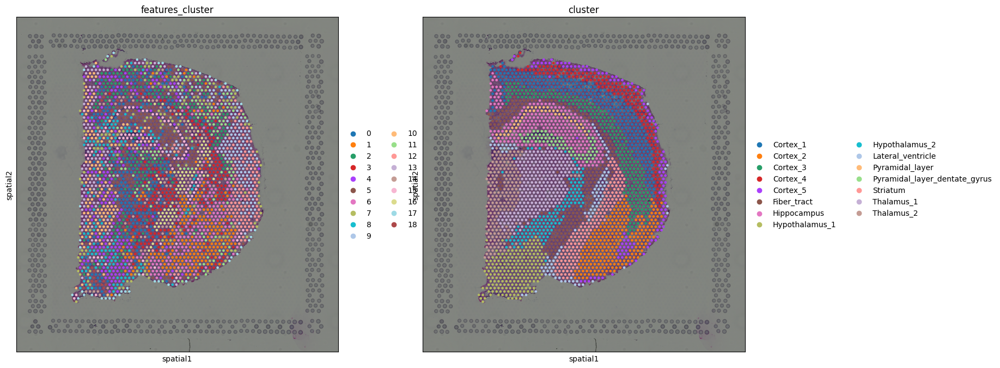

In [108]:
# helper function returning a clustering
def cluster_features(features: pd.DataFrame, like=None) -> pd.Series:
    """
    Calculate leiden clustering of features.

    Specify filter of features using `like`.
    """
    # filter features
    if like is not None:
        features = features.filter(like=like)
    # create temporary adata to calculate the clustering
    adata = ad.AnnData(features)
    # important - feature values are not scaled, so need to scale them before PCA
    sc.pp.scale(adata)
    # calculate leiden clustering
    sc.pp.pca(adata, n_comps=min(10, features.shape[1] - 1))
    sc.pp.neighbors(adata)
    sc.tl.leiden(adata)

    return adata.obs["leiden"]


# calculate feature clusters
adata.obs["features_cluster"] = cluster_features(adata.obsm["features"], like="summary")

# compare feature and gene clusters
sq.pl.spatial_scatter(adata, color=["features_cluster", "cluster"])

Comparing gene and feature clusters, we notice that in some regions, they look very similar, like the cluster Fiber_tract, or clusters around the Hippocampus seems to be roughly recapitulated by the clusters in image feature space. In others, the feature clusters look different, like in the cortex, where the gene clusters show the layered structure of the cortex, and the features clusters rather seem to show different regions of the cortex.

This is only a simple, comparative analysis of the image features, note that you could also use the image features to e.g. compute a common image and gene clustering by computing a shared neighbors graph (for instance on concatenated PCAs on both feature spaces).

<div style="border: 1px solid #ffa6a6; padding: 10px; border-radius: 5px;">
<span style="color: #ff6666; font-size: 20px;"><b>Reflection Point:</b></span> <span style="font-size: 20px;">Integration of Image Features and Gene Expression</span>  
<ul>
    <li>Extract and analyze image features alongside gene expression data in spatial transcriptomics.</li>
</ul>
<p>Reflect on the following:</p>
<ol>
    <li>Why is it important to integrate image features with gene expression data in spatial transcriptomics?</li>
    <li>What complementary biological or technical insights can be gained by combining these data types?</li>
    <li>How might multi-scale or segmentation features help in identifying spatial patterns in tissue?</li>
</ol>
</div>

In [155]:
from IPython.display import display, HTML

# Define the reflection question with green styling
reflection_question = """
<div style="border: 1px solid #90ee90; padding: 10px; border-radius: 5px;">
<span style="color: #32cd32; font-size: 16px;"><b>Quick recap on image features</b></span>
</div>
"""

# Define the hidden answer with collapsible content
hidden_answer = """
<details>
<summary>Click to reveal the answer</summary>
<p>
Integrating image features with gene expression data in spatial transcriptomics is important because:
<ul>
    <li><b>Complementary Information:</b> Image features provide morphological context that can complement gene expression data. For example, differences in tissue structure may align with gene expression differences.</li>
    <li><b>Biological Insights:</b> By analyzing both data types, we can uncover relationships between tissue morphology and cellular function, such as identifying specific cell types or spatial gradients.</li>
    <li><b>Multi-scale Features:</b> Features calculated at different crop sizes and scales can reveal hierarchical patterns, such as cell-level versus tissue-level organization.</li>
    <li><b>Technical Benefits:</b> Combining data types may help mitigate noise in one modality by validating it with insights from the other.</li>
</ul>
By leveraging multi-scale and segmentation features, we can enhance our understanding of how gene expression and morphology contribute to spatial tissue organization.
</p>
</details>
"""

# Display the reflection question with hidden answer
display(HTML(reflection_question + hidden_answer))


Comparing gene and feature clusters, we notice that in some regions, they look very similar, like the cluster Fiber_tract, or clusters around the Hippocampus seems to be roughly recapitulated by the clusters in image feature space. In others, the feature clusters look different, like in the cortex, where the gene clusters show the layered structure of the cortex, and the features clusters rather seem to show different regions of the cortex.

This is only a simple, comparative analysis of the image features, note that you could also use the image features to e.g. compute a common image and gene clustering by computing a shared neighbors graph (for instance on concatenated PCAs on both feature spaces).

In [112]:
adata2=adata

In [113]:
# Ensure PCA is performed on gene expression
sc.pp.pca(adata2, n_comps=50)  # Adjust number of PCs as needed

# Combine gene PCs and image features
combined_features = np.concatenate([adata2.obsm["X_pca"], adata2.obsm["features"]], axis=1)
adata2.obsm["combined"] = combined_features

computing PCA
    with n_comps=50
    finished (0:00:02)


In [114]:
# Compute neighbors graph on combined features
sc.pp.neighbors(adata2, use_rep="combined", n_neighbors=15)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [115]:
sc.tl.leiden(adata2, key_added="combined_cluster")

running Leiden clustering
    finished: found 19 clusters and added
    'combined_cluster', the cluster labels (adata.obs, categorical) (0:00:00)


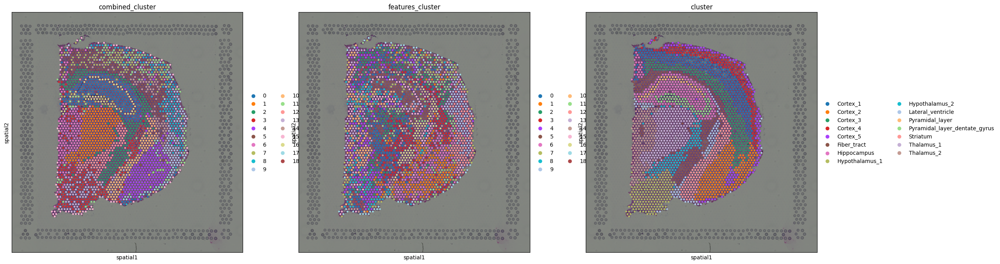

In [117]:
# Compare spatial clusters
sq.pl.spatial_scatter(adata2, color=["combined_cluster", "features_cluster", "cluster"])

# # Optional: Compare UMAPs
# sc.tl.umap(adata2)
# sc.pl.umap(adata2, color=["combined_cluster", "features_cluster", "cluster"])

### Spatial statistics and graph analysis


Similar to other spatial data, we can investigate spatial organization by leveraging spatial and graph statistics in Visium data.

Neighborhood enrichment

Computing a neighborhood enrichment can help us identify spots clusters that share a common neighborhood structure across the tissue. We can compute such score with the following function: `squidpy.gr.nhood_enrichment()`. In short, it’s an enrichment score on spatial proximity of clusters: if spots belonging to two different clusters are often close to each other, then they will have a high score and can be defined as being enriched. On the other hand, if they are far apart, and therefore are seldom a neighborhood, the score will be low and they can be defined as depleted. This score is based on a permutation-based test, and you can set the number of permutations with the `n_perms` argument (default is 1000).

Since the function works on a connectivity matrix, we need to compute that as well. This can be done with squidpy.gr.spatial_neighbors(). Please see Building spatial neighbors graph for more details of how this function works.

Finally, we’ll directly visualize the results with `squidpy.pl.nhood_enrichment()`.

Creating graph using `grid` coordinates and `None` transform and `1` libraries.
Adding `adata.obsp['spatial_connectivities']`
       `adata.obsp['spatial_distances']`
       `adata.uns['spatial_neighbors']`
Finish (0:00:00)
Calculating neighborhood enrichment using `1` core(s)


  0%|          | 0/1000 [00:00<?, ?/s]

/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/numba/core/decorators.py:246: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)


Adding `adata.uns['cluster_nhood_enrichment']`
Finish (0:00:03)


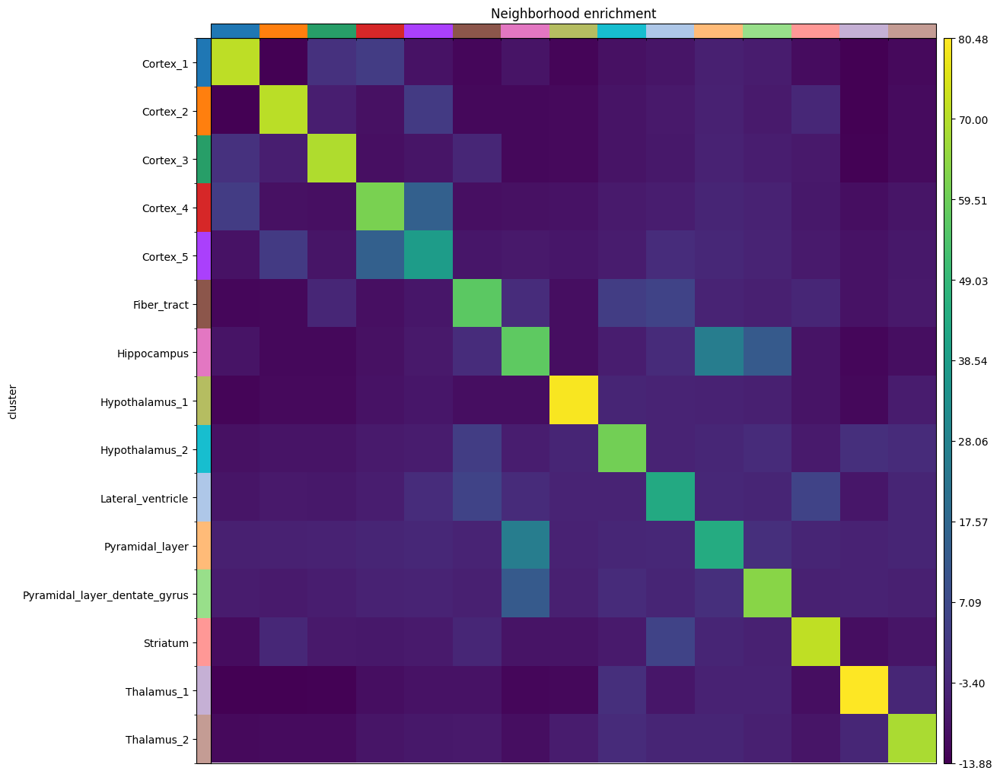

In [118]:
sq.gr.spatial_neighbors(adata)
sq.gr.nhood_enrichment(adata, cluster_key="cluster")
sq.pl.nhood_enrichment(adata, cluster_key="cluster")

Given the spatial organization of the mouse brain coronal section, not surprisingly we find high neighborhood enrichment the Hippocampus region: Pyramidal_layer_dentate_gyrus and Pyramidal_layer clusters seems to be often neighbors with the larger Hippocampus cluster.

/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/squidpy/pl/_color_utils.py:28: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]


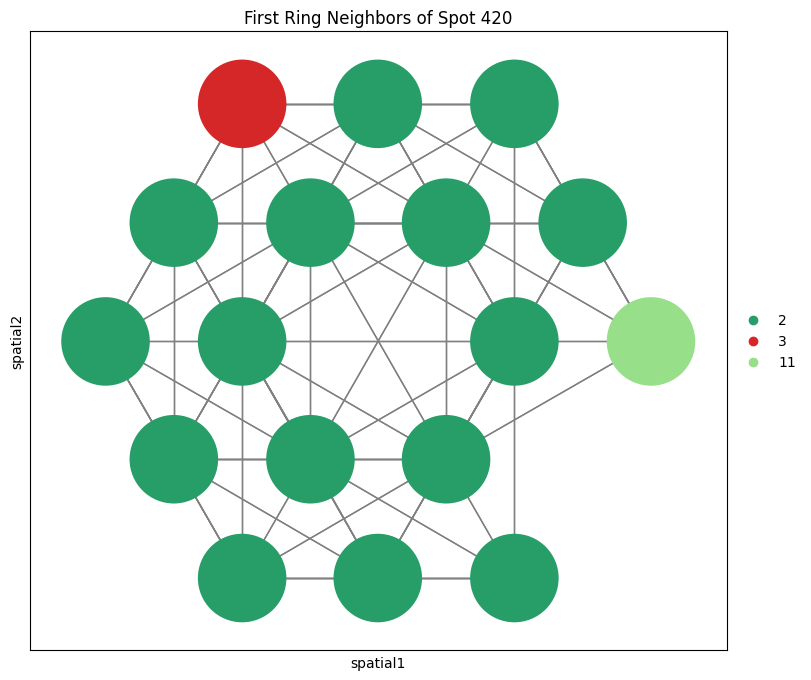

In [136]:
# Get neighbors for a specific point
_, first_ring_idx = adata_visium.obsp["spatial_connectivities"][420, :].nonzero()

# Highlight neighbors in the first ring
sq.pl.spatial_scatter(
    adata_visium[first_ring_idx, :],
    color="leiden",  # Use cluster or another attribute for color coding
    connectivity_key="spatial_connectivities",
    img=False,
    size=1,
    title="First Ring Neighbors of Spot 420",
)

/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/squidpy/pl/_color_utils.py:28: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]


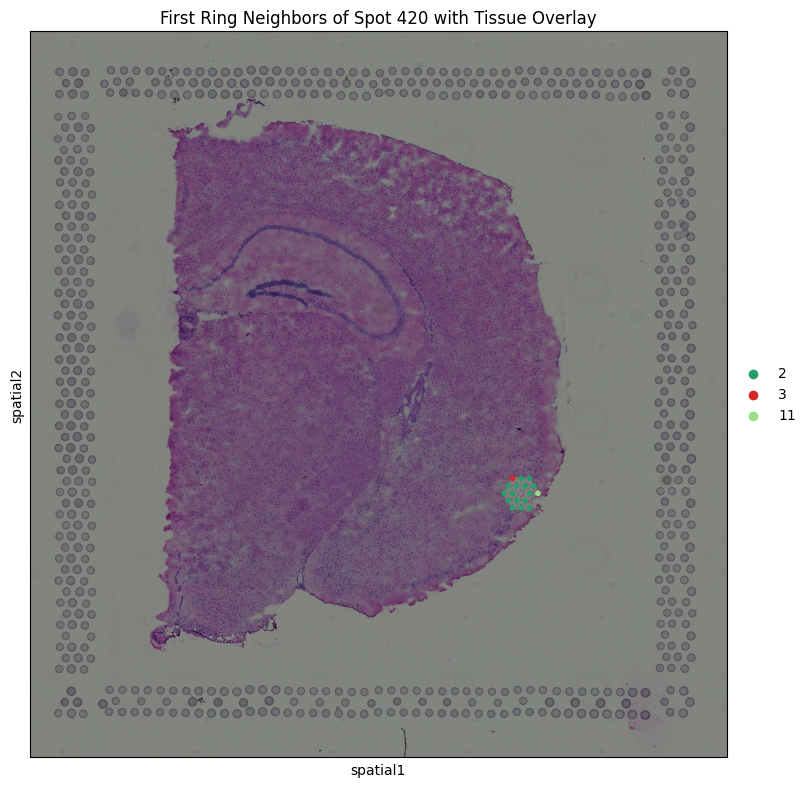

In [142]:
sq.pl.spatial_scatter(
    adata_visium[first_ring_idx, :],
    color="leiden",
    connectivity_key="spatial_connectivities",
    library_id="V1_Adult_Mouse_Brain",
    img=True,  # Enable image overlay
    #spot_size=1,
    title="First Ring Neighbors of Spot 420 with Tissue Overlay",
)


Co-occurrence across spatial dimensions

In addition to the neighbor enrichment score, we can visualize cluster co-occurrence in spatial dimensions. This is a similar analysis of the one presented above, yet it does not operate on the connectivity matrix, but on the original spatial coordinates. The co-occurrence score is defined as:

.. math:: \frac{p(exp|cond)}{p(exp)}

where
 is the conditional probability of observing a cluster
 conditioned on the presence of a cluster
, whereas
 is the probability of observing
 in the radius size of interest. The score is computed across increasing radii size around each observation (i.e. spots here) in the tissue.

We are gonna compute such score with squidpy.gr.co_occurrence() and set the cluster annotation for the conditional probability with the argument clusters. Then, we visualize the results with squidpy.pl.co_occurrence().

Calculating co-occurrence probabilities for `50` intervals `1` split combinations using `1` core(s)


  0%|          | 0/1 [00:00<?, ?/s]

/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/numba/core/decorators.py:246: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)


Adding `adata.uns['cluster_co_occurrence']`
Finish (0:00:04)


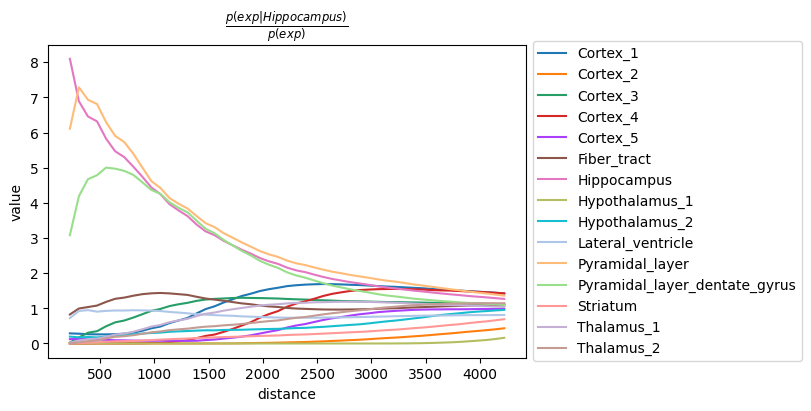

In [150]:
sq.gr.co_occurrence(adata, cluster_key="cluster")
sq.pl.co_occurrence(
    adata,
    cluster_key="cluster",
    clusters="Hippocampus",
    figsize=(8, 4),
)

The result largely recapitulates the previous analysis: the Pyramidal_layer cluster seem to co-occur at short distances with the larger Hippocampus cluster. It should be noted that the distance units are given in pixels of the Visium source_image, and corresponds to the same unit of the spatial coordinates saved in adata.obsm['spatial'].

<div style="border: 1px solid #ffa6a6; padding: 10px; border-radius: 5px;"> <span style="color: #ff6666; font-size: 20px;"><b>Reflection Point:</b></span> <span style="font-size: 20px;">Co-occurrence Across Spatial Dimensions</span> <ul> <li>How does cluster co-occurrence enhance our understanding of spatial tissue organization?</li> <li>What are the advantages of using co-occurrence scores instead of relying solely on the connectivity matrix?</li> <li>How does varying the radius size affect the observed co-occurrence patterns?</li> </ul> <p>Reflect on the following:</p> <ol> <li>What biological factors could lead to high co-occurrence scores between specific clusters?</li> <li>How might co-occurrence patterns differ between regions of interest (e.g., hippocampus vs. cortex)?</li> <li>What additional analyses could complement co-occurrence metrics to better understand spatial dependencies?</li> </ol> </div>

In [156]:
# Define the reflection question with green styling
reflection_question = """
<div style="border: 1px solid #90ee90; padding: 10px; border-radius: 5px;">
<span style="color: #32cd32; font-size: 16px;"><b>Insights on spatial co-occurrence</b></span>
</div>
"""

# Define the hidden answer with collapsible content
hidden_answer = """
<details>
<summary>Click to reveal the answer</summary>
<p>
Spatial co-occurrence analysis offers several advantages for understanding tissue organization:
<ul>
    <li><b>Functional Relationships:</b> Co-occurrence scores highlight clusters that frequently exist in proximity, suggesting potential functional interactions, such as cell-cell signaling or shared microenvironments.</li>
    <li><b>Tissue Microenvironments:</b> This method helps identify distinct regions where specific clusters are overrepresented, like specialized immune zones or areas of neurogenesis.</li>
    <li><b>Spatial Gradients:</b> By varying radius sizes, we can observe how co-occurrence patterns change across scales, from immediate neighbors to broader tissue regions.</li>
    <li><b>Cluster Dependencies:</b> High co-occurrence between clusters can imply functional dependencies or developmental trajectories in spatial contexts.</li>
    <li><b>Biological Examples:</b> In brain tissue, co-occurrence between neural progenitors and glial cells may indicate regions of active development or repair.</li>
</ul>
By integrating co-occurrence with gene expression data, we can uncover deeper insights into how spatial relationships drive biological processes.
</p>
</details>
"""

# Display the reflection question with hidden answer
display(HTML(reflection_question + hidden_answer))

In [159]:
# Define the reflection question with green styling
reflection_question = """
<div style="border: 1px solid #90ee90; padding: 10px; border-radius: 5px;">
<span style="color: #32cd32; font-size: 16px;"><b>Co-occurrence vs. Neighborhood Analysis</b></span>
</div>
"""

# Define the hidden answer with collapsible content
hidden_answer = """
<details>
<summary>Click to reveal the answer</summary>
<p>
While both co-occurrence and neighborhood analysis explore spatial relationships, they differ in scope and interpretation:
<ul>
    <li><b>Neighborhood Analysis:</b> 
        <ul>
            <li>Focuses on direct spatial relationships using adjacency in a connectivity matrix (e.g., neighbors defined by spatial proximity).</li>
            <li>Useful for identifying immediate microenvironments and interactions between adjacent spots or cells.</li>
            <li>Often combined with spatial autocorrelation metrics (e.g., Moran's I) to assess spatial clustering of gene expression.</li>
        </ul>
    </li>
    <li><b>Co-occurrence Analysis:</b>
        <ul>
            <li>Operates on original spatial coordinates and calculates conditional probabilities of clusters appearing together within a radius.</li>
            <li>Captures broader spatial patterns and dependencies beyond direct neighbors.</li>
            <li>Ideal for understanding regional relationships and cluster co-localization across varying scales.</li>
        </ul>
    </li>
</ul>
<b>Key Differences:</b>
<ul>
    <li>Neighborhood analysis is localized and adjacency-based, while co-occurrence considers probabilities across spatial scales.</li>
    <li>Co-occurrence can reveal long-range spatial dependencies not captured in the immediate neighborhood.</li>
</ul>
<b>Example Applications:</b>
<ul>
    <li>Neighborhood analysis is useful for studying interactions between adjacent clusters, such as immune cell-cell interactions.</li>
    <li>Co-occurrence highlights regional patterns, such as zones where specific cell types frequently appear together (e.g., tumor microenvironments).</li>
</ul>
By combining both approaches, we can obtain a comprehensive view of spatial organization and interactions within tissues.
</p>
</details>
"""

# Display the reflection question with hidden answer
display(HTML(reflection_question + hidden_answer))

Spatially variable genes with Moran’s I

Finally, we might be interested in finding genes that show spatial patterns. There are several methods that aimed at address this explicitly, based on point processes or Gaussian process regression framework:

SPARK - paper <https://www.nature.com/articles/s41592-019-0701-7#Abs1>, code <https://github.com/xzhoulab/SPARK>.

Spatial DE - paper <https://www.nature.com/articles/nmeth.4636>, code <https://github.com/Teichlab/SpatialDE>.

trendsceek - paper <https://www.nature.com/articles/nmeth.4634>, code <https://github.com/edsgard/trendsceek>.

HMRF - paper <https://www.nature.com/articles/nbt.4260>, code <https://bitbucket.org/qzhudfci/smfishhmrf-py>.

Here, we provide a simple approach based on the well-known Moran's I statistics <https://en.wikipedia.org/wiki/Moran%27s_I>_ which is in fact used also as a baseline method in the spatially variable gene papers listed above. The function in Squidpy is called squidpy.gr.spatial_autocorr(), and returns both test statistics and adjusted p-values in anndata.AnnData.var slot. For time reasons, we will evaluate a subset of the highly variable genes only.

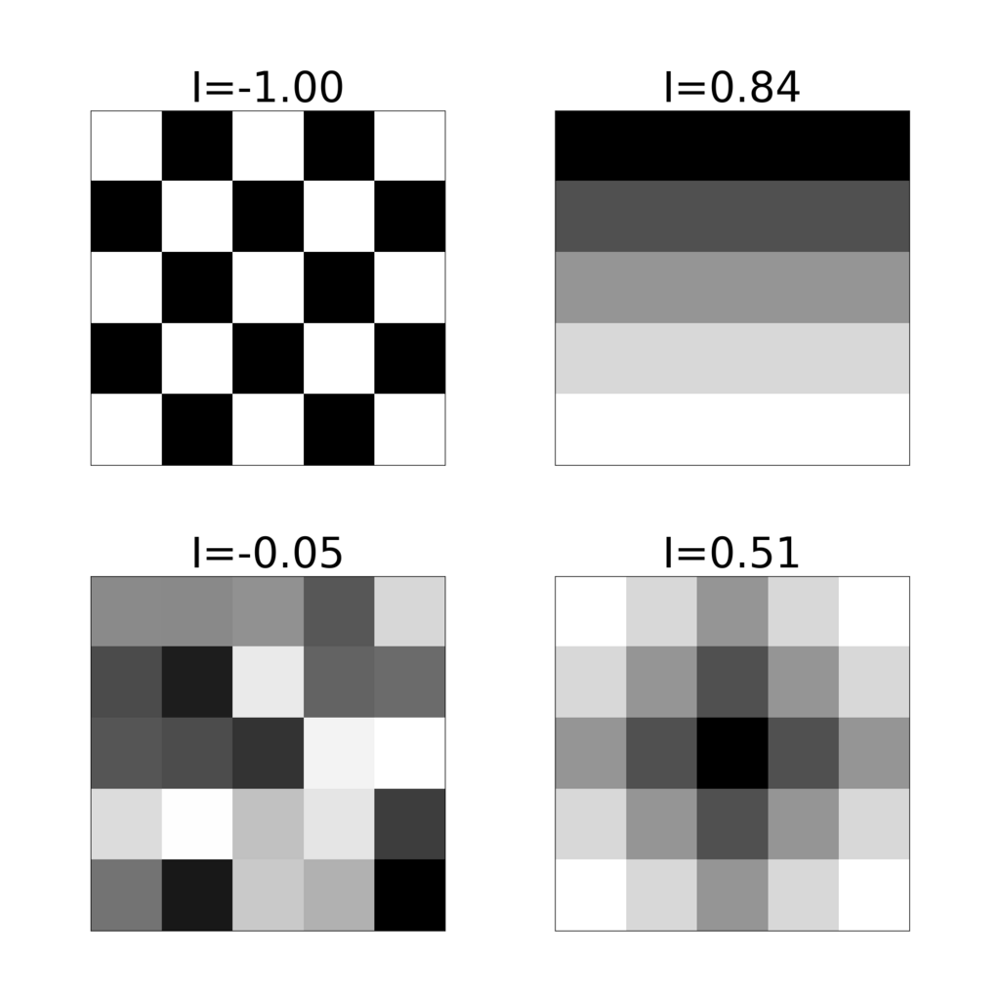

In [158]:
from IPython.display import Image, display

# Display the PNG image with adjusted width
display(Image(filename="moranI.png", width=400))  # Adjust width as needed

In [151]:
genes = adata[:, adata.var.highly_variable].var_names.values[:1000]
sq.gr.spatial_autocorr(
    adata,
    mode="moran",
    genes=genes,
    n_perms=100,
    n_jobs=1,
)

Calculating moran's statistic for `100` permutations using `1` core(s)


  0%|          | 0/100 [00:00<?, ?/s]

/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/numba/core/decorators.py:246: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)


Adding `adata.uns['moranI']`
Finish (0:00:06)


In [152]:
adata.uns["moranI"].head(10)

,I,pval_norm,var_norm,pval_z_sim,pval_sim,var_sim,pval_norm_fdr_bh,pval_z_sim_fdr_bh,pval_sim_fdr_bh
Olfm1,0.701320,0.0,0.000045,0.0,0.009901,0.000227,0.0,0.0,0.01142
Itpka,0.684974,0.0,0.000045,0.0,0.009901,0.000251,0.0,0.0,0.01142
Plp1,0.684790,0.0,0.000045,0.0,0.009901,0.000226,0.0,0.0,0.01142
Nnat,0.670006,0.0,0.000045,0.0,0.009901,0.000272,0.0,0.0,0.01142
Snap25,0.642858,0.0,0.000045,0.0,0.009901,0.000259,0.0,0.0,0.01142
Shox2,0.639423,0.0,0.000045,0.0,0.009901,0.000225,0.0,0.0,0.01142
Synpo2,0.636267,0.0,0.000045,0.0,0.009901,0.000226,0.0,0.0,0.01142
Dbi,0.626847,0.0,0.000045,0.0,0.009901,0.000227,0.0,0.0,0.01142
3110035E14Rik,0.625294,0.0,0.000045,0.0,0.009901,0.000218,0.0,0.0,0.01142
Chn1,0.625060,0.0,0.000045,0.0,0.009901,0.000215,0.0,0.0,0.01142


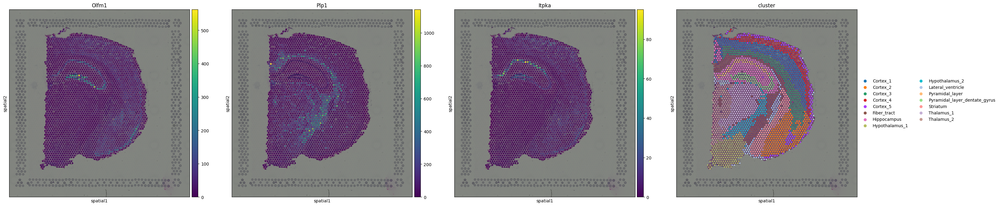

In [153]:
sq.pl.spatial_scatter(adata, color=["Olfm1", "Plp1", "Itpka", "cluster"])

<div style="border: 1px solid #ffa6a6; padding: 10px; border-radius: 5px;"> <span style="color: #ff6666; font-size: 20px;"><b>Reflection Point:</b></span> <span style="font-size: 20px;">Interpreting Moran's I</span> <ul> <li>What does a high Moran's I score indicate about the spatial distribution of a gene?</li> <li>How might Moran's I scores vary between highly structured tissues (e.g., brain) and less organized ones (e.g., blood)?</li> <li>What factors could contribute to a low or negative Moran's I score for a gene?</li> </ul> <p>Reflect on the following:</p> <ol> <li>Which genes in your dataset show strong spatial autocorrelation? What does this suggest about their biological roles?</li> <li>Can Moran's I results be used to prioritize genes for downstream analyses? How?</li> <li>What additional spatial metrics (e.g., Geary's C) could complement Moran's I for understanding gene spatial patterns?</li> </ol> </div>

In [160]:
# Define the reflection question with green styling
reflection_question = """
<div style="border: 1px solid #90ee90; padding: 10px; border-radius: 5px;">
<span style="color: #32cd32; font-size: 16px;"><b>Insights into Moran's I</b></span>
</div>
"""

# Define the hidden answer with collapsible content
hidden_answer = """
<details>
<summary>Click to reveal the answer</summary>
<p>
Moran's I provides a measure of spatial autocorrelation, revealing spatial relationships in the dataset:
<ul>
    <li><b>High Moran's I:</b> Indicates strong spatial autocorrelation, meaning the gene is expressed in localized clusters or gradients. Such genes might define tissue compartments, functional zones, or biological boundaries.</li>
    <li><b>Low Moran's I:</b> Suggests random spatial distribution or lack of strong spatial patterns. This may occur for housekeeping genes or genes not relevant to spatial organization.</li>
    <li><b>Negative Moran's I:</b> Indicates spatial dispersion or inversely correlated neighborhoods, which might reflect competition or antagonistic spatial processes.</li>
</ul>

<b>Factors Influencing Moran's I:</b>
<ul>
    <li><b>Tissue Architecture:</b> Highly structured tissues like the brain or liver might show stronger autocorrelation for specific genes compared to less organized ones.</li>
    <li><b>Gene Expression Noise:</b> Noise in low-expressed genes can lower Moran's I scores.</li>
    <li><b>Biological Functions:</b> Genes involved in local signaling or cell-cell interactions are more likely to show high Moran's I scores.</li>
</ul>

<b>Using Moran's I:</b>
<ul>
    <li>Genes with high Moran's I scores are good candidates for studying spatially resolved biological processes or regional markers.</li>
    <li>Moran's I can guide spatial clustering, co-occurrence analysis, or functional enrichment based on spatial patterns.</li>
</ul>

<b>Complementary Metrics:</b>
<ul>
    <li><b>Geary's C:</b> Another spatial metric that emphasizes local variation rather than global trends.</li>
    <li><b>Neighborhood Enrichment:</b> Useful for understanding local interactions in addition to global autocorrelation.</li>
</ul>
</p>
</details>
"""

# Display the reflection question with hidden answer
display(HTML(reflection_question + hidden_answer))

## `SpatialData` advanced visualisations for Visium and Visium HD

### Visium analysis

In this section, we will explore how to use spatialdata-plot to generate static plots of various different technologies. When we load the spatialdata-plot library, this adds the .pl accessor to every SpatialData object, which gives us access to the plotting functions. Their logic is loosly inspired by the ggplot-library in R, in which one can chain multiple function calls, gradually building the final figure.

In particular, the library exposes the following functions:

* SpatialData.pl.render_images()
* SpatialData.pl.render_labels()
* SpatialData.pl.render_points()
* SpatialData.pl.render_shapes()
* SpatialData.pl.show()


We can chain the 4 render_xxx functions to gradually build up a figure, with a final call to show to then actually render out the function. In the following sections we will explore these functions further.

Let's first visualize the individual contained modalities separately. When rendering the images, we see that we get two plots. That's because the SpatialData object contains two coordinate systems (downscaled_hires and downscaled_lowres) with images aligned to them. The global coordinate system doesn't contain any, as visible above.

In [5]:
import spatialdata as sd
import spatialdata_plot as sdp
from spatialdata_io import visium, visium_hd, xenium
import matplotlib.pyplot as plt  # for multi-panel plots later

In [162]:
data_path = "./data/"

In [166]:
sdata_visium = visium(data_path + "visium_coronal")

INFO     reading data/visium_coronal/V1_Adult_Mouse_Brain_filtered_feature_bc_matrix.h5                            


/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1756: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1756: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/spatialdata/models/models.py:1035: UserWarning: Converting `region_key: region` to categorical dtype.
  return convert_region_column_to_categorical(adata)


INFO     Dropping coordinate system 'global' since it doesn't have relevant elements.                              
INFO     Rasterizing image for faster rendering.                                                                   


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04605263..1.0131578].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.11214953..1.0560747].


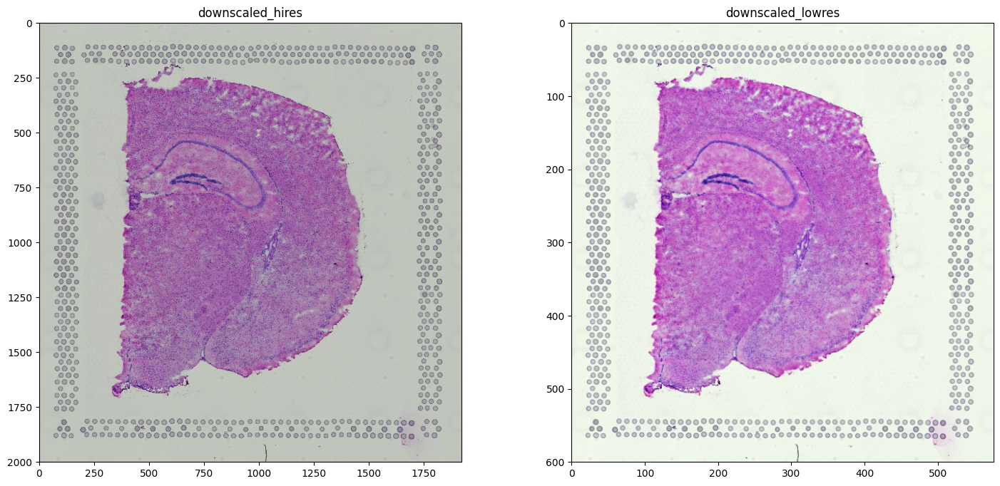

In [167]:
sdata_visium.pl.render_images().pl.show()

We can pass the name of a specific coordinate system to the pl.show() function to only render elements of that coordinate system.

INFO     Rasterizing image for faster rendering.                                                                   


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04605263..1.0131578].


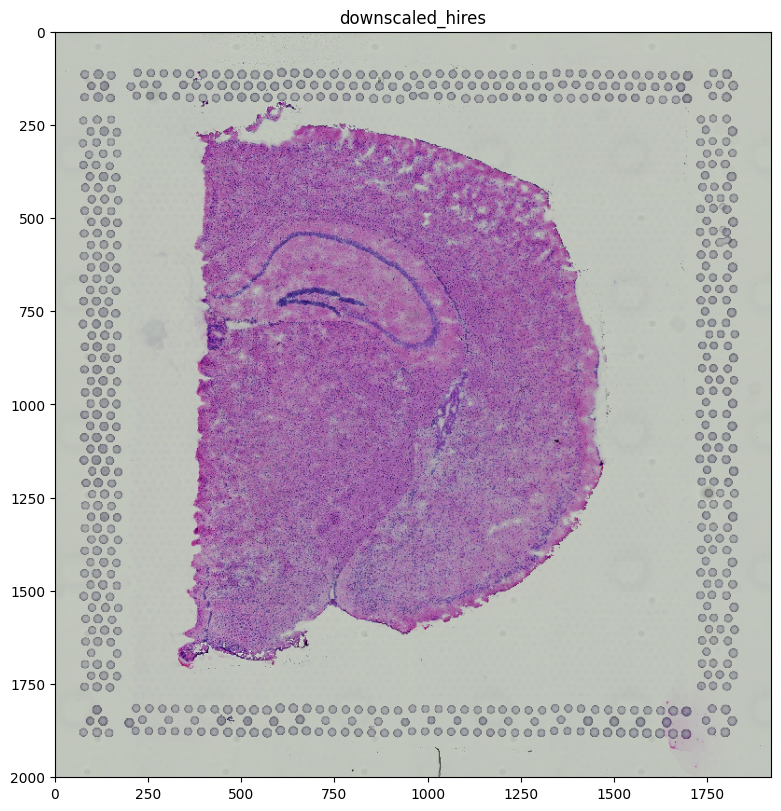

In [168]:
sdata_visium.pl.render_images().pl.show(coordinate_systems="downscaled_hires")

The Visium technology works by detecting transcripts in specific circular caption locations (often referred to as "Visium spots") on a slide. The circular capture locations are defined by the Shapes slot, which contains their coordinates. The Tables slot contains the actual transcript counts for each capture location. We can use the render_shapes function to overlay these circular locations onto our image.

INFO     Rasterizing image for faster rendering.                                                                   


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04605263..1.0131578].


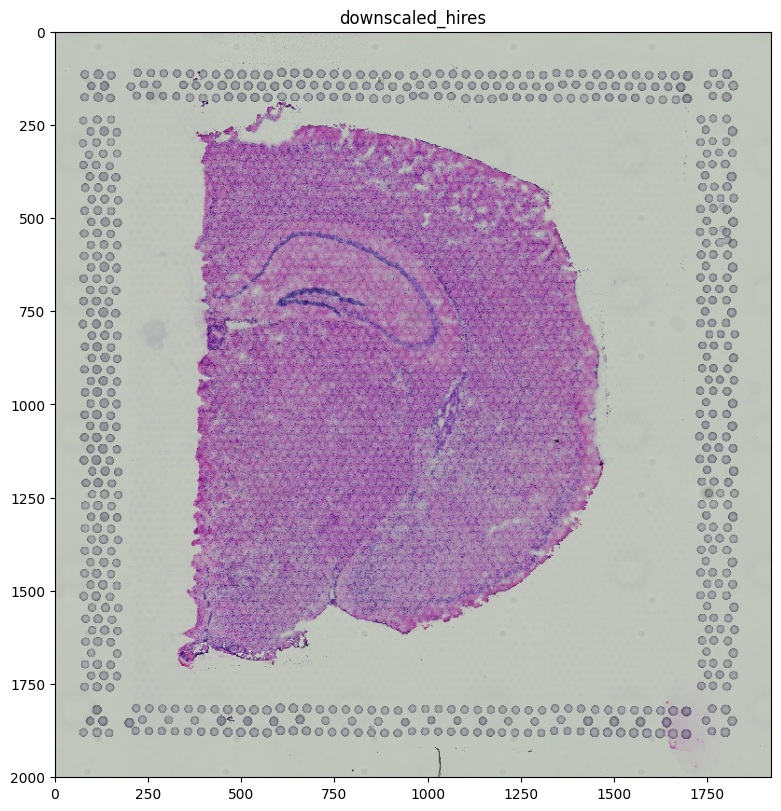

In [169]:
(
    sdata_visium.pl.render_images()
    .pl.render_shapes(fill_alpha=0.2)
    .pl.show("downscaled_hires", figsize=(8, 8))
)

We’re going to create a naiive visualisation of the data, overlaying the Visium spots and the tissue images. For this, we need to load the spatialdata_plot library which extends the sd.SpatialData object with the .pl module.

## `SpatialData` interoperability with `Scanpy` and `Squidpy`

However, simply overlaying these locations doesn't really contain much information. Ideally we want to investigate spatial trends in the gene expression data. For this we're going to use Squidpy, another scverse package that contains several spatial analysis tools. We'll use it to calculate the spatial autocorrelation of some genes, more specifically Moran's I. This measure describes how homogenous a gene is expressed across a slide:

In [170]:
adata_visium = sdata_visium.table

sq.gr.spatial_neighbors(adata_visium)
sq.gr.spatial_autocorr(
    adata_visium,
    mode="moran",
    genes=adata_visium.var_names,
    n_perms=10,
    n_jobs=1,
)

Creating graph using `grid` coordinates and `None` transform and `1` libraries.
Adding `adata.obsp['spatial_connectivities']`
       `adata.obsp['spatial_distances']`
       `adata.uns['spatial_neighbors']`
Finish (0:00:00)


/var/folders/hr/f3msc_bs3z53n3_m4c4ry6tc0000gn/T/ipykernel_1153/829487675.py:1: DeprecationWarning: Table accessor will be deprecated with SpatialData version 0.1, use sdata.tables instead.
  adata_visium = sdata_visium.table
/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/scanpy/metrics/_common.py:62: UserWarning: 10336 variables were constant, will return nan for these.
  warnings.warn(


Calculating moran's statistic for `10` permutations using `1` core(s)


  0%|          | 0/10 [00:00<?, ?/s]

/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/numba/core/decorators.py:246: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)


Adding `adata.uns['moranI']`
Finish (0:00:08)


In [171]:
print(adata_visium.uns["moranI"])

                   I  pval_norm  var_norm  pval_z_sim  pval_sim   var_sim  \
Sparc       0.811384        0.0   0.00013         0.0  0.090909  0.000202   
Camk2n1     0.806069        0.0   0.00013         0.0  0.090909  0.000426   
Mbp         0.766683        0.0   0.00013         0.0  0.090909  0.000156   
Resp18      0.755050        0.0   0.00013         0.0  0.090909  0.000673   
Bc1         0.742980        0.0   0.00013         0.0  0.090909  0.000215   
...              ...        ...       ...         ...       ...       ...   
AC124606.2       NaN        NaN   0.00013         NaN  0.090909       NaN   
AC124606.1       NaN        NaN   0.00013         NaN  0.090909       NaN   
AC133095.2       NaN        NaN   0.00013         NaN  0.090909       NaN   
AC133095.1       NaN        NaN   0.00013         NaN  0.090909       NaN   
AC234645.1       NaN        NaN   0.00013         NaN  0.090909       NaN   

            pval_norm_fdr_bh  pval_z_sim_fdr_bh  pval_sim_fdr_bh  
Sparc   

In [172]:
print(adata_visium.uns["moranI"].head(3))
print(abs(adata_visium.uns["moranI"][~adata_visium.uns["moranI"]["I"].isna()]).tail(3))

                I  pval_norm  var_norm  pval_z_sim  pval_sim   var_sim  \
Sparc    0.811384        0.0   0.00013         0.0  0.090909  0.000202   
Camk2n1  0.806069        0.0   0.00013         0.0  0.090909  0.000426   
Mbp      0.766683        0.0   0.00013         0.0  0.090909  0.000156   

         pval_norm_fdr_bh  pval_z_sim_fdr_bh  pval_sim_fdr_bh  
Sparc                 NaN                NaN         0.112426  
Camk2n1               NaN                NaN         0.112426  
Mbp                   NaN                NaN         0.112426  
                I  pval_norm  var_norm    pval_z_sim  pval_sim   var_sim  \
Klf12    0.022674   0.025021   0.00013  1.136297e-04  0.090909  0.000032   
Plekhg2  0.023117   0.022832   0.00013  2.537304e-08  0.090909  0.000027   
Hvcn1    0.025815   0.012690   0.00013  2.841815e-08  0.090909  0.000022   

         pval_norm_fdr_bh  pval_z_sim_fdr_bh  pval_sim_fdr_bh  
Klf12                 NaN                NaN         0.112426  
Plekhg2       

Let's visualise the spatial expression of the 3 genes with the highest and lowest Moran's I scores each. We'll use classic matplotlib synthax to construct the multi-panel figure.

INFO     Rasterizing image for faster rendering.                                                                   


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04605263..1.0131578].


INFO     Rasterizing image for faster rendering.                                                                   


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04605263..1.0131578].


INFO     Rasterizing image for faster rendering.                                                                   


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04605263..1.0131578].


INFO     Rasterizing image for faster rendering.                                                                   


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04605263..1.0131578].


INFO     Rasterizing image for faster rendering.                                                                   


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04605263..1.0131578].


INFO     Rasterizing image for faster rendering.                                                                   


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04605263..1.0131578].


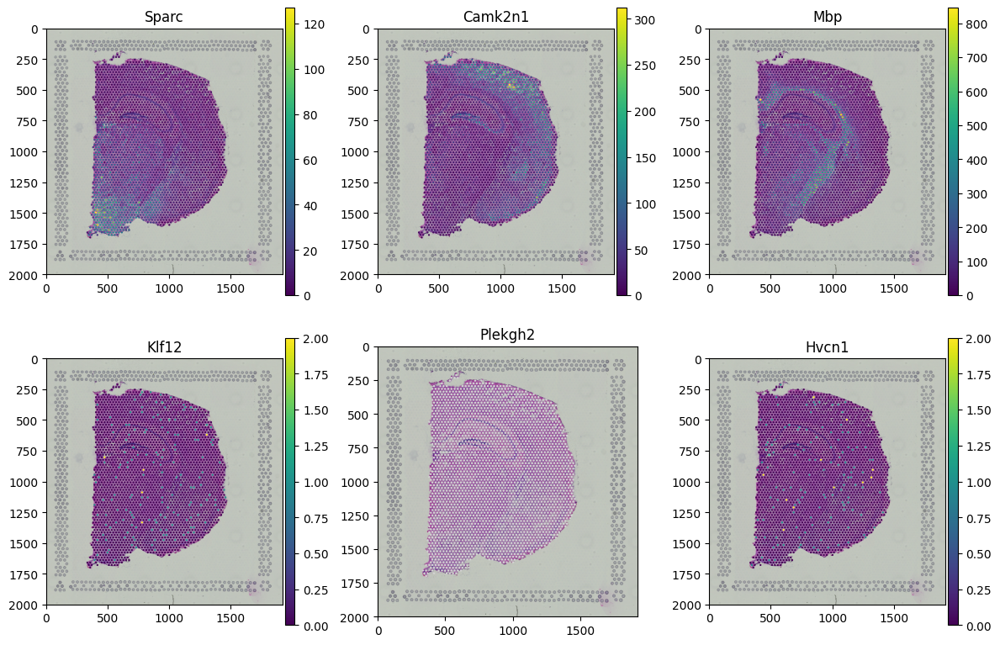

In [173]:
fig, axs = plt.subplots(2, 3, figsize=(12, 8))

for idx, gene in enumerate(["Sparc", "Camk2n1", "Mbp", "Klf12", 'Plekgh2', 'Hvcn1']):
    (
        sdata_visium.pl.render_images()
        .pl.render_shapes(color=f"{gene}")
        .pl.show("downscaled_hires", ax=axs[idx // 3, idx % 3], title=gene)
    )

fig.tight_layout()

Generally, the spatialdata-plot library tries to be as flexible as possible, allowing for a wide range of different plotting options. However, this flexibility comes at the cost of some complexity. To limit the amount of permutations we have to account for in the codebase, we recommend a workflow in which one gradually builds up a figure on an ax object. If multiple similar plots are required, it is currently the easiest way, to manually assign them to their panels, for example like this:

INFO     Rasterizing image for faster rendering.                                                                   


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04137931..1.0137931].


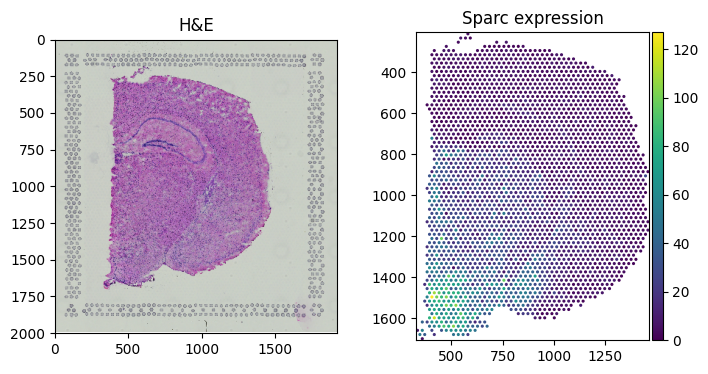

In [174]:
fig, axs = plt.subplots(1, 2, figsize=(8, 4))

sdata_visium.pl.render_images().pl.show("downscaled_hires", ax=axs[0], title="H&E")

sdata_visium.pl.render_shapes(color="Sparc").pl.show(
    "downscaled_hires", ax=axs[1], title="Sparc expression"
)

## SpatialData

In [181]:
# !wget -O visium_hd.zip https://s3.embl.de/spatialdata/spatialdata-sandbox/visium_hd_3.0.0_io.zip

--2025-01-11 17:52:53--  https://s3.embl.de/spatialdata/spatialdata-sandbox/visium_hd_3.0.0_io.zip
194.94.45.80.embl.de (s3.embl.de)... 
connected. to s3.embl.de (s3.embl.de)|194.94.45.80|:443... 
HTTP request sent, awaiting response... 200 OK
Length: 2449895320 (2,3G) [application/zip]
Saving to: ‘visium_hd.zip’

visium_hd.zip       100%[===================>]   2,28G  2,53MB/s    in 15m 22s 

2025-01-11 18:08:16 (2,53 MB/s) - ‘visium_hd.zip’ saved [2449895320/2449895320]



In [188]:
# !unzip visium_hd.zip -d ./data/visium_hd_zarr

Archive:  visium_hd.zip
   creating: ./data/visium_hd_zarr/data.zarr/
  inflating: ./data/visium_hd_zarr/data.zarr/zmetadata  
 extracting: ./data/visium_hd_zarr/data.zarr/.zgroup  
   creating: ./data/visium_hd_zarr/data.zarr/shapes/
   creating: ./data/visium_hd_zarr/data.zarr/shapes/Visium_HD_Mouse_Small_Intestine_square_002um/
  inflating: ./data/visium_hd_zarr/data.zarr/shapes/Visium_HD_Mouse_Small_Intestine_square_002um/shapes.parquet  
 extracting: ./data/visium_hd_zarr/data.zarr/shapes/Visium_HD_Mouse_Small_Intestine_square_002um/.zgroup  
  inflating: ./data/visium_hd_zarr/data.zarr/shapes/Visium_HD_Mouse_Small_Intestine_square_002um/.zattrs  
 extracting: ./data/visium_hd_zarr/data.zarr/shapes/.zgroup  
   creating: ./data/visium_hd_zarr/data.zarr/shapes/Visium_HD_Mouse_Small_Intestine_square_008um/
  inflating: ./data/visium_hd_zarr/data.zarr/shapes/Visium_HD_Mouse_Small_Intestine_square_008um/shapes.parquet  
 extracting: ./data/visium_hd_zarr/data.zarr/shapes/Visium_HD_Mou

In [ ]:
# !mv ./visium_hd/data.zarr ./visium_hd.zarr

In [3]:
visium_hd_zarr_path = "./data/visium_hd_zarr/data.zarr"

In [6]:
sdata_visium_hd = sd.read_zarr(visium_hd_zarr_path)
sdata_visium_hd

/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1756: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1756: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1756: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


SpatialData object, with associated Zarr store: /Users/georgegavriilidis/Downloads/data/visium_hd_zarr/data.zarr
├── Images
│     ├── 'Visium_HD_Mouse_Small_Intestine_cytassist_image': DataArray[cyx] (3, 3000, 3200)
│     ├── 'Visium_HD_Mouse_Small_Intestine_full_image': DataTree[cyx] (3, 21943, 23618), (3, 10971, 11809), (3, 5485, 5904), (3, 2742, 2952), (3, 1371, 1476)
│     ├── 'Visium_HD_Mouse_Small_Intestine_hires_image': DataArray[cyx] (3, 5575, 6000)
│     └── 'Visium_HD_Mouse_Small_Intestine_lowres_image': DataArray[cyx] (3, 558, 600)
├── Shapes
│     ├── 'Visium_HD_Mouse_Small_Intestine_square_002um': GeoDataFrame shape: (5479660, 1) (2D shapes)
│     ├── 'Visium_HD_Mouse_Small_Intestine_square_008um': GeoDataFrame shape: (351817, 1) (2D shapes)
│     └── 'Visium_HD_Mouse_Small_Intestine_square_016um': GeoDataFrame shape: (91033, 1) (2D shapes)
└── Tables
      ├── 'square_002um': AnnData (5479660, 19059)
      ├── 'square_008um': AnnData (351817, 19059)
      └── 'square_016u

In [7]:
sdata_visium_hd.tables["square_008um"].var_names_make_unique()  # modifies in-place

In [8]:
# for table in sdata.tables.values():
#     table.var_names_make_unique()

NameError: name 'sdata' is not defined

INFO     Dropping coordinate system 'downscaled_lowres' since it doesn't have relevant elements.                   
INFO     Dropping coordinate system 'downscaled_hires' since it doesn't have relevant elements.                    


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.15..1.0].


INFO     Dropping coordinate system 'downscaled_lowres' since it doesn't have relevant elements.                   
INFO     Dropping coordinate system 'downscaled_hires' since it doesn't have relevant elements.                    
INFO     Rasterizing image for faster rendering.                                                                   


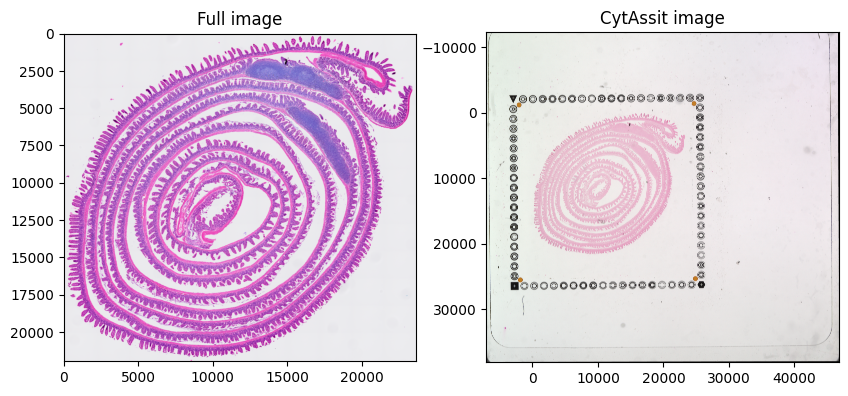

In [9]:
import matplotlib.pyplot as plt
import spatialdata_plot

axes = plt.subplots(1, 2, figsize=(10, 5))[1].flatten()
sdata_visium_hd.pl.render_images("Visium_HD_Mouse_Small_Intestine_full_image").pl.show(ax=axes[0], title="Full image")
sdata_visium_hd.pl.render_images("Visium_HD_Mouse_Small_Intestine_cytassist_image").pl.show(ax=axes[1], title="CytAssit image")

We will use the .query.bounding_box() function to subset the data so that we can visually inspect the result easier. This function allows us to subset the data to a specific bounding box, which is defined by the top-left and bottom-right coordinates. This is useful when working with large datasets, as it allows us to only load the data that we're interested in.

In [10]:
sdata_visium_hd_crop = sdata_visium_hd.query.bounding_box(
    axes=["x", "y"],
    min_coordinate=[4500, 0],
    max_coordinate=[6000, 1500],
    target_coordinate_system="downscaled_hires",
)

/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1756: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [11]:
sdata_visium_hd_crop

SpatialData object
├── Images
│     └── 'Visium_HD_Mouse_Small_Intestine_hires_image': DataArray[cyx] (3, 1500, 1500)
├── Shapes
│     ├── 'Visium_HD_Mouse_Small_Intestine_square_002um': GeoDataFrame shape: (350777, 1) (2D shapes)
│     ├── 'Visium_HD_Mouse_Small_Intestine_square_008um': GeoDataFrame shape: (22688, 1) (2D shapes)
│     └── 'Visium_HD_Mouse_Small_Intestine_square_016um': GeoDataFrame shape: (5943, 1) (2D shapes)
└── Tables
      ├── 'square_002um': AnnData (350777, 19059)
      ├── 'square_008um': AnnData (22688, 19059)
      └── 'square_016um': AnnData (5943, 19059)
with coordinate systems:
    ▸ 'downscaled_hires', with elements:
        Visium_HD_Mouse_Small_Intestine_hires_image (Images), Visium_HD_Mouse_Small_Intestine_square_002um (Shapes), Visium_HD_Mouse_Small_Intestine_square_008um (Shapes), Visium_HD_Mouse_Small_Intestine_square_016um (Shapes)
    ▸ 'downscaled_lowres', with elements:
        Visium_HD_Mouse_Small_Intestine_square_002um (Shapes), Visium_HD_Mou

In [234]:
# Access the specific AnnData table
adata_table = sdata_visium_hd_crop.tables["square_008um"]  # Replace "table_name" with the actual table name

# Make variable names unique
adata_table.var_names_make_unique()

# Reassign the updated table back to the SpatialData object (optional if you need to reuse it)
sdata_visium_hd_crop.tables["square_008um"] = adata_table

/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/spatialdata/_core/_elements.py:116: UserWarning: Key `square_008um` already exists. Overwriting it in-memory.
  self._check_key(key, self.keys(), self._shared_keys)


In [235]:
# Access the specific AnnData table
adata_table2 = sdata_visium_hd_crop.tables["square_002um"]  # Replace "table_name" with the actual table name

# Make variable names unique
adata_table2.var_names_make_unique()

# Reassign the updated table back to the SpatialData object (optional if you need to reuse it)
sdata_visium_hd_crop.tables["square_002um"] = adata_table2

/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/spatialdata/_core/_elements.py:116: UserWarning: Key `square_002um` already exists. Overwriting it in-memory.
  self._check_key(key, self.keys(), self._shared_keys)


In [236]:
# Access the specific AnnData table
adata_table3 = sdata_visium_hd_crop.tables["square_016um"]  # Replace "table_name" with the actual table name

# Make variable names unique
adata_table3.var_names_make_unique()

# Reassign the updated table back to the SpatialData object (optional if you need to reuse it)
sdata_visium_hd_crop.tables["square_016um"] = adata_table3

/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/spatialdata/_core/_elements.py:116: UserWarning: Key `square_016um` already exists. Overwriting it in-memory.
  self._check_key(key, self.keys(), self._shared_keys)


In [237]:
sdata_visium_hd_crop.tables["square_008um"].to_df().apply(
    lambda col: col.var(), axis=0
).sort_values()

Ptpn20           0.000000
Olfr718-ps1      0.000000
Spdye4b          0.000000
Zfp853           0.000000
Pou6f2           0.000000
                  ...    
Iglc1           45.842403
Lyz1            50.397385
Defa21          58.193329
Igha           189.171158
Igkc           215.507874
Length: 19059, dtype: float32

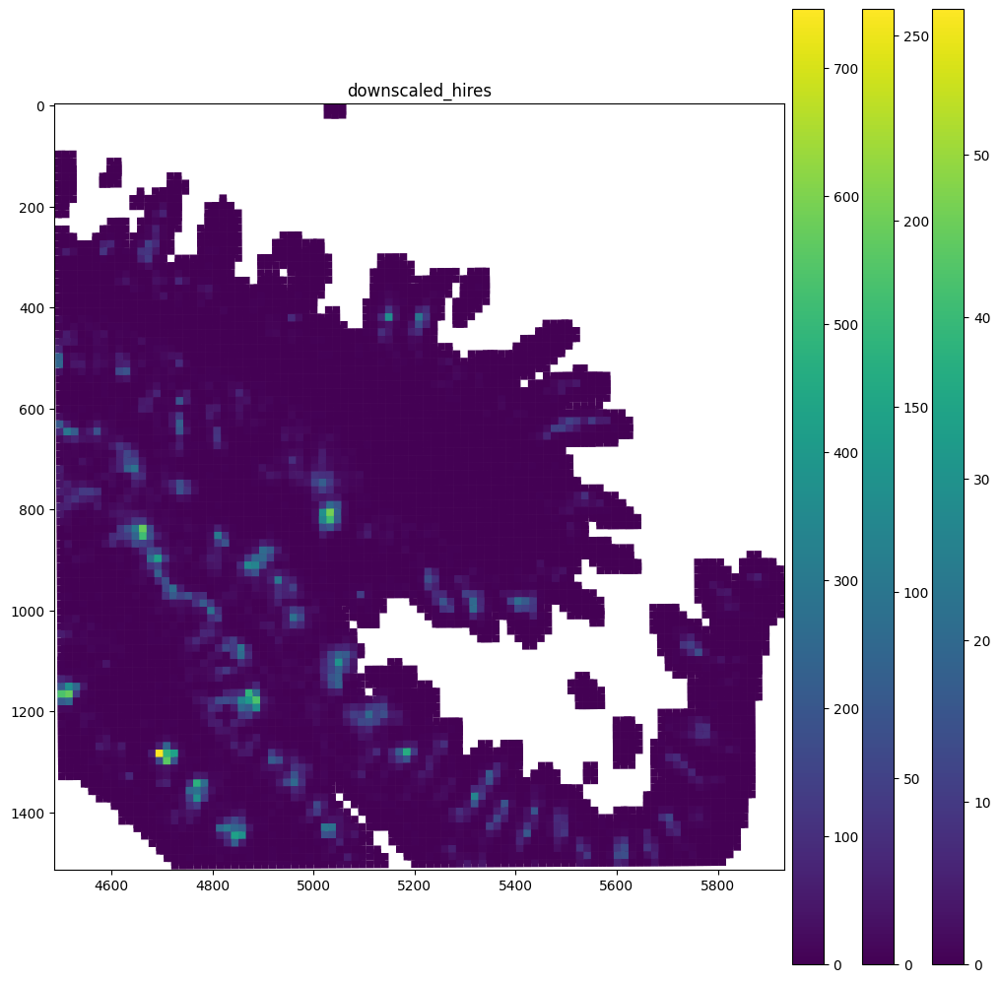

In [238]:
sdata_visium_hd_crop.pl.render_shapes(color="Igha", method="matplotlib").pl.show(
    "downscaled_hires", figsize=(10, 10)
)

We can see that these bins are continous, so when overlaying the expression over an image, we would no longer see the image. To counter this, we will modify the colormap we'll use so that true 0s in the expression matrix are shown fully transparent. The spatialdata-plot library provides a helper function for this.

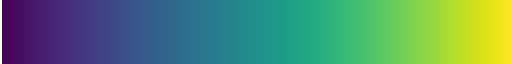

In [239]:
from spatialdata_plot.pl.utils import set_zero_in_cmap_to_transparent

cmap = set_zero_in_cmap_to_transparent(plt.cm.viridis)
cmap

We can now use this cmap to visualise the spatial expression of the genes. We see that the gene is only expressed in certain areas of the slide.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16513762..1.0].


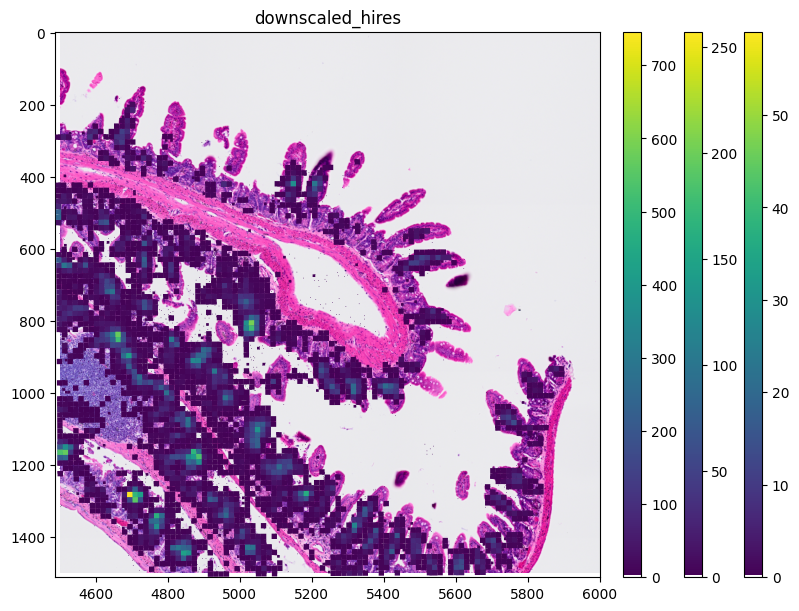

In [240]:
sdata_visium_hd_crop.pl.render_images().pl.render_shapes(
    color="Igha", method="matplotlib", cmap=cmap
).pl.show("downscaled_hires", figsize=(8, 6))

In [12]:
# Import necessary libraries
import spatialdata as sd
from spatialdata_plot.pl.utils import set_zero_in_cmap_to_transparent
import matplotlib.pyplot as plt

In [13]:
# Define a function to crop a specific region
def crop_region(sdata, min_coord, max_coord):
    return sdata.query.bounding_box(
        axes=["x", "y"],
        min_coordinate=min_coord,
        max_coordinate=max_coord,
        target_coordinate_system="global",
    )

INFO     Using 'datashader' backend with 'sum' as reduction method to speed up plotting. Depending on the reduction
         method, the value range of the plot might change. Set method to 'matplotlib' do disable this behaviour.   
INFO     Using the datashader reduction "sum". "max" will give an output very close to the matplotlib result.      
INFO     alpha component of given RGBA value for outline color is discarded, because outline_alpha takes precedent.
CPU times: user 5.61 s, sys: 1.59 s, total: 7.2 s
Wall time: 7.85 s


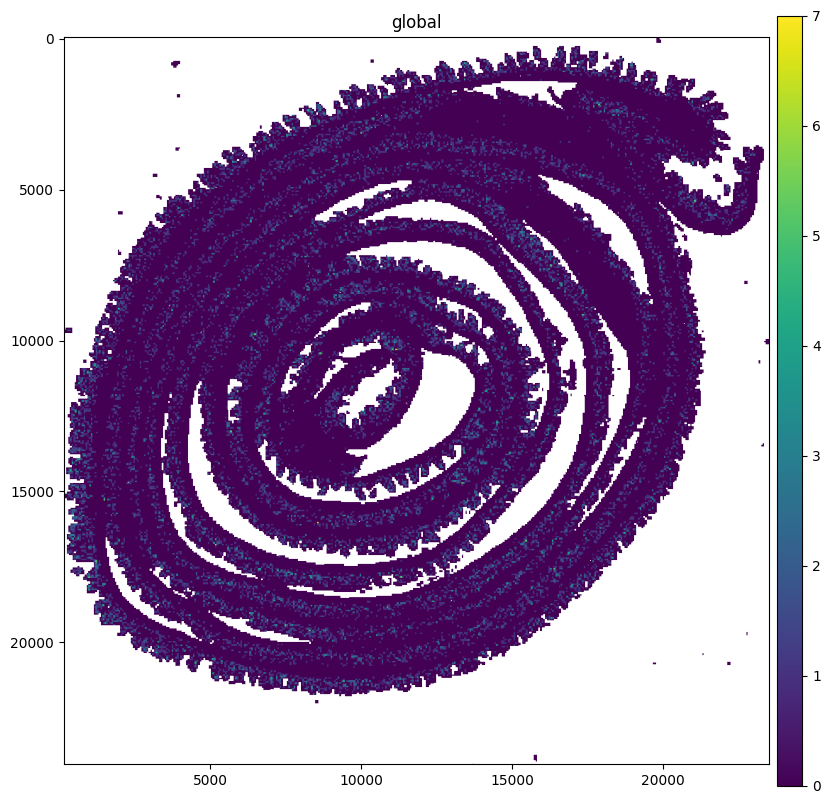

In [16]:
%%time
plt.figure(figsize=(10, 10))
ax = plt.gca()

gene_name = "AA986860"
sdata_visium_hd.pl.render_shapes("Visium_HD_Mouse_Small_Intestine_square_016um", color=gene_name, method="datashader").pl.show(
    coordinate_systems="global", ax=ax
)

### Performant on-the-fly data rasterization

Let’s now pre-compute a lazy-rasterized version of the data using `rasterize_bins()`. This operation takes just a few seconds and unlocks very fast on-demand channel-wise rasterization.

In [17]:
%%time
from spatialdata import rasterize_bins

for bin_size in ["016", "008", "002"]:
    # rasterize_bins() requires a compresed sparse column (csc) matrix
    sdata_visium_hd.tables[f"square_{bin_size}um"].X = sdata_visium_hd.tables[f"square_{bin_size}um"].X.tocsc()
    rasterized = rasterize_bins(
        sdata_visium_hd,
        f"Visium_HD_Mouse_Small_Intestine_square_{bin_size}um",
        f"square_{bin_size}um",
        "array_col",
        "array_row",
    )
    sdata_visium_hd[f"rasterized_{bin_size}um"] = rasterized

CPU times: user 4.24 s, sys: 992 ms, total: 5.23 s
Wall time: 4.31 s


This produces lazy image objects that can be accessed gene-wise exceptionally efficiently.

Importantly, these objects should not be computed as a whole, because this would lead to the unnecessary computation of hundreds of GB of memory.

In [18]:
%%time
# this is very fast
sdata_visium_hd["rasterized_002um"].sel(c=gene_name).compute()
# this must not be called
# sdata["rasterized_002um"].compute()

CPU times: user 27.4 ms, sys: 10.7 ms, total: 38.1 ms
Wall time: 38.1 ms


<xarray.DataArray 'image' (y: 3285, x: 3191)> Size: 42MB
array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)
Coordinates:
    c        <U8 32B 'AA986860'
  * y        (y) float64 26kB 0.5 1.5 2.5 3.5 ... 3.282e+03 3.284e+03 3.284e+03
  * x        (x) float64 26kB 0.5 1.5 2.5 3.5 ... 3.188e+03 3.19e+03 3.19e+03
Attributes:
    transform:  {'global': Sequence \n    Sequence \n        Affine (x, y -> ...

Here is an example of how to plot the rasterized data. Please pay attention to setting scale="full"; this is essential. If it is not set, spatialdata-plot will try to re-rasterize the data to fit the canvas size and try to compute the whole object.

CPU times: user 219 ms, sys: 10 ms, total: 229 ms
Wall time: 227 ms


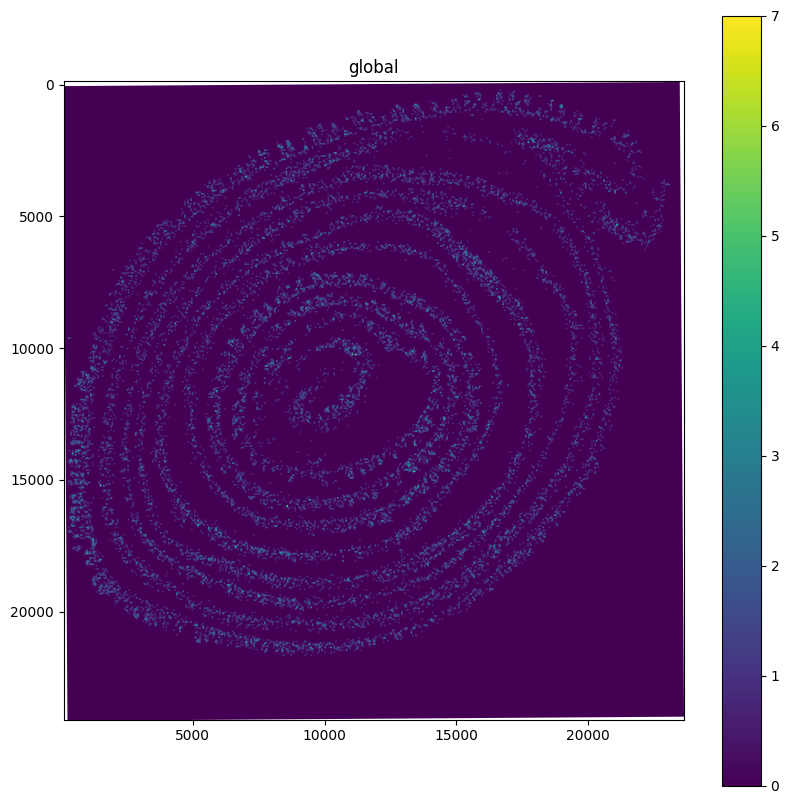

In [19]:
%%time
plt.figure(figsize=(10, 10))
ax = plt.gca()

sdata_visium_hd.pl.render_images("rasterized_016um", channel=gene_name, scale="full").pl.show(coordinate_systems="global", ax=ax)

As you can see below, we can plot the 2µm bins very performantly, which would not be possible with the matplotlib based approach shown before.

Note: when we plot the full data below the plot appears as uniformly violet. This happens because the data is very sparse and the bins are too small for the target figure size; since most of the non-zero bins are 1s the final interpolated colors are very close to the zero value and difficult to see.

Let’s therefore:

change the limits of the plot to show a portion of the data to avoid interpolation artifacts

plot a binary mask of the full data to avoid the interpolated data to be to close to 0.

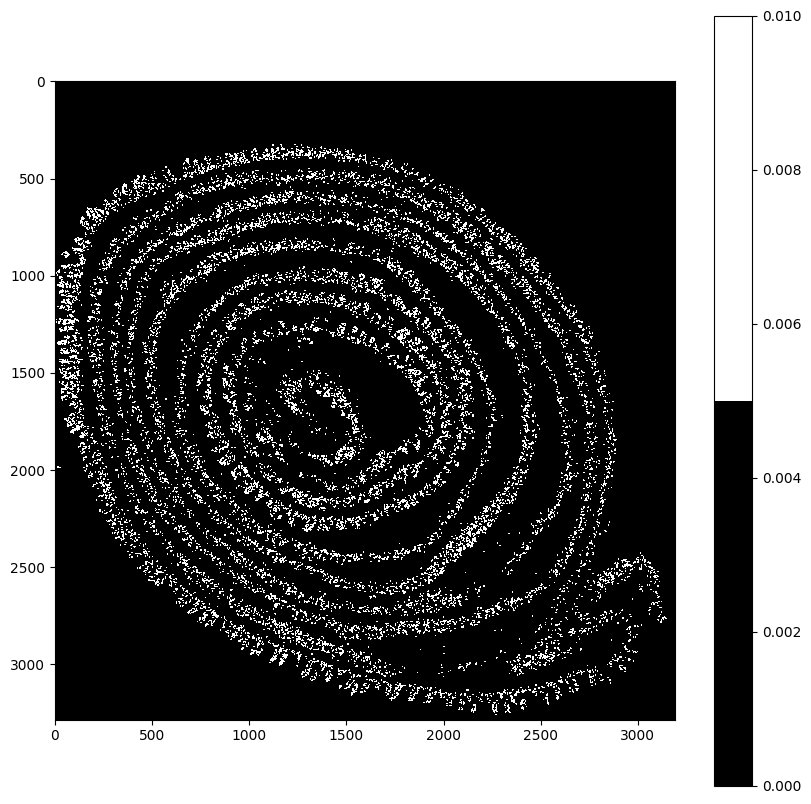

In [21]:
from matplotlib.colors import ListedColormap

# define the colors for the colormap (black for zeros, white for > 0)
colors = ["#000000", "#ffffff"]  # Black, White
cmap = ListedColormap(colors)

plt.figure(figsize=(10, 10))

# bug: interpolation artifact, everything is black with a few sporadic white points: https://github.com/scverse/spatialdata-plot/issues/351
# ax = plt.gca()
# let's set a small vmax value so that the color is white also after interpolation
# sdata.pl.render_images("rasterized_002um", channel=gene_name, scale="full", vmin=0, vmax=0.01, cmap=cmap).pl.show(
# coordinate_systems="global", ax=ax
# )

# workaround
plt.imshow(sdata_visium_hd["rasterized_002um"].sel(c=gene_name).data.compute(), cmap=cmap, vmin=0, vmax=0.01)
plt.colorbar()

plt.show()

As a final not on the on-the-fly rasterization approach. Please, by looking at the corners of the last plot, notice how the data is on a grid that is actually sligthly rotated. The advantage of using rasterize_bins() is that the produced object contains the coordinate transformations necessary to align (rotation and scale) the rasterized data together with the high-resolution images.

### Plotting subsets of the data

In [22]:
sdata_small = sdata_visium_hd.query.bounding_box(
    min_coordinate=[7000, 11000], max_coordinate=[10000, 14000], axes=("x", "y"), target_coordinate_system="global"
)

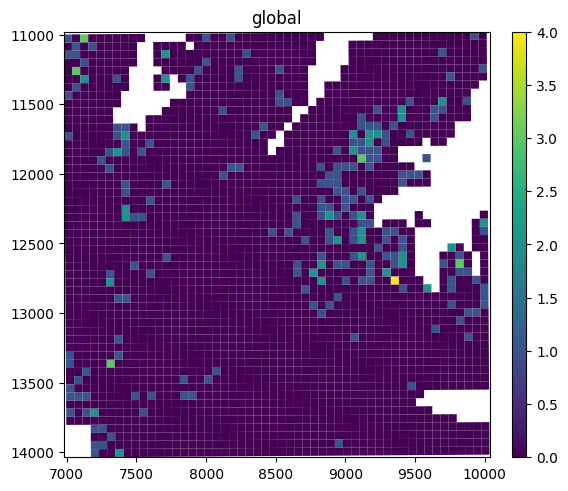

In [23]:
gene_name = "AA986860"
sdata_small.pl.render_shapes("Visium_HD_Mouse_Small_Intestine_square_016um", color=gene_name).pl.show(
    coordinate_systems="global"
)

Notice how a Moiré pattern is visible. This is due to the fact that the grid is not axis-aligned but presents a small rotation. A solution is to switch to datashader as a backend (which is enabled by default when the number of geometries is large). This will create some artifacts (bins of different sizes, some “holes” in the plot), but generally is expected to mitigate the effects as opposed the plot above.

INFO     Using 'datashader' backend with 'sum' as reduction method to speed up plotting. Depending on the reduction
         method, the value range of the plot might change. Set method to 'matplotlib' do disable this behaviour.   
INFO     Using the datashader reduction "sum". "max" will give an output very close to the matplotlib result.      
INFO     alpha component of given RGBA value for outline color is discarded, because outline_alpha takes precedent.


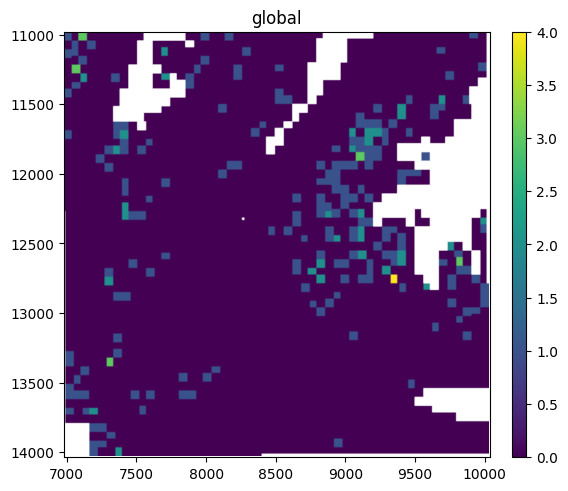

In [24]:
gene_name = "AA986860"
sdata_small.pl.render_shapes(
    "Visium_HD_Mouse_Small_Intestine_square_016um", color=gene_name, method="datashader"
).pl.show(coordinate_systems="global")

INFO     Using 'datashader' backend with 'sum' as reduction method to speed up plotting. Depending on the reduction
         method, the value range of the plot might change. Set method to 'matplotlib' do disable this behaviour.   
INFO     Using the datashader reduction "sum". "max" will give an output very close to the matplotlib result.      
INFO     alpha component of given RGBA value for outline color is discarded, because outline_alpha takes precedent.
INFO     Using 'datashader' backend with 'sum' as reduction method to speed up plotting. Depending on the reduction
         method, the value range of the plot might change. Set method to 'matplotlib' do disable this behaviour.   
INFO     Using the datashader reduction "sum". "max" will give an output very close to the matplotlib result.      
INFO     alpha component of given RGBA value for outline color is discarded, because outline_alpha takes precedent.


/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


INFO     Using 'datashader' backend with 'sum' as reduction method to speed up plotting. Depending on the reduction
         method, the value range of the plot might change. Set method to 'matplotlib' do disable this behaviour.   
INFO     Using the datashader reduction "sum". "max" will give an output very close to the matplotlib result.      


/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


INFO     alpha component of given RGBA value for outline color is discarded, because outline_alpha takes precedent.


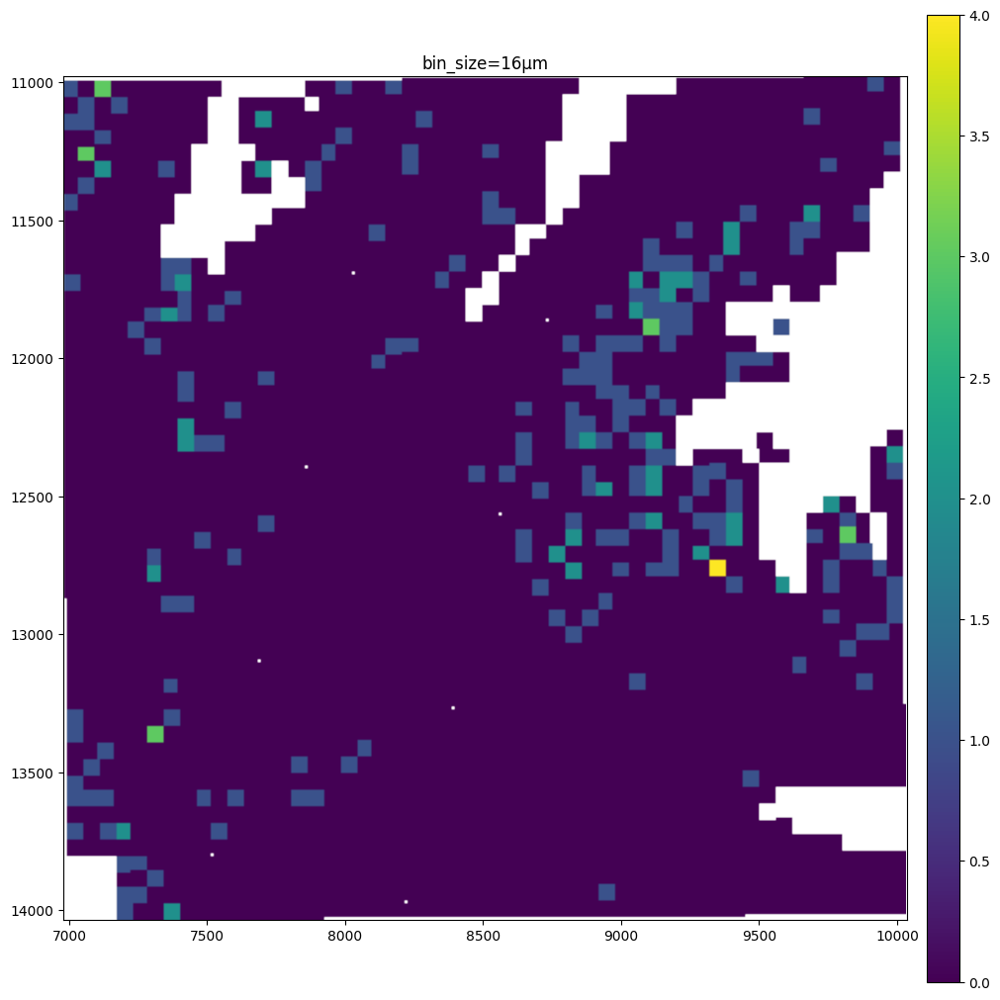

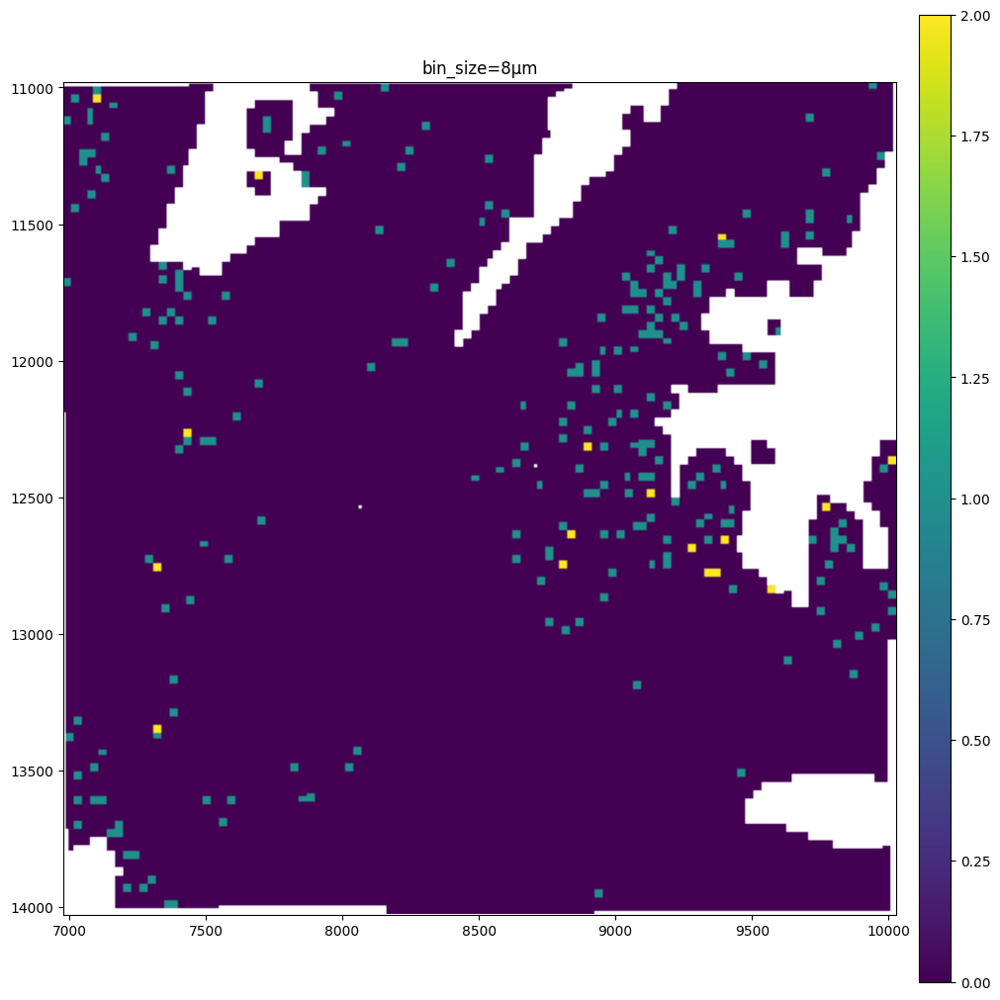

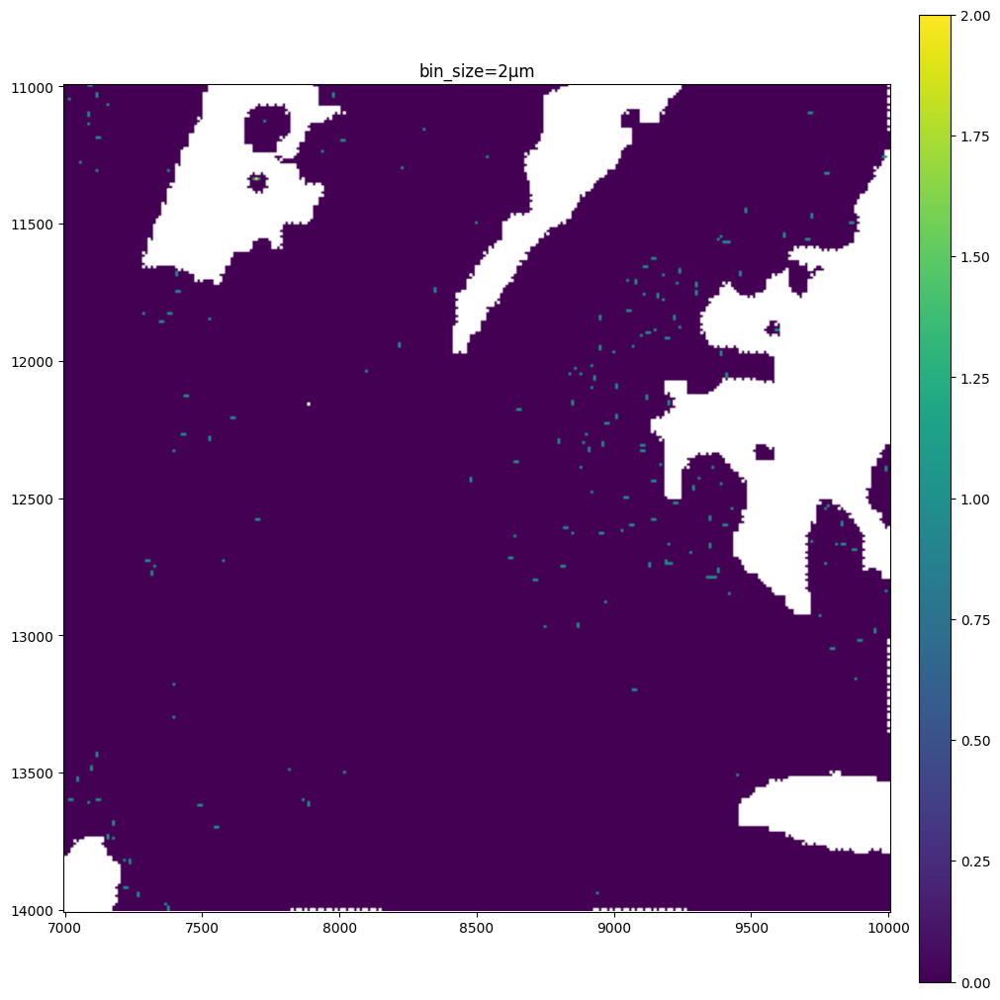

In [25]:
gene_name = "AA986860"

for bin_size in [16, 8, 2]:
    sdata_small.pl.render_shapes(
        f"Visium_HD_Mouse_Small_Intestine_square_{bin_size:03}um",
        color=gene_name,
        method="datashader",
    ).pl.show(coordinate_systems="global", title=f"bin_size={bin_size}µm", figsize=(10, 10))

The data present a lot of sparsity. Let’s remake the plots above by visualizing only the non-zero entries and using the full-resolution image as a background.

We will do this by modifying the viridis colormap so that 0 is plotted as transparent. Let’s also truncate the viridis colormap so that the highest value is colored green and not yellow since green has a better contrast against the pink of the H&E microscopy image.

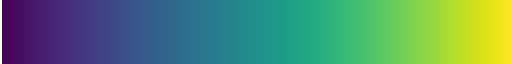

In [26]:
from spatialdata_plot.pl.utils import set_zero_in_cmap_to_transparent

# let's display the areas where no expression is detected as transparent
new_cmap = set_zero_in_cmap_to_transparent(cmap="viridis")
new_cmap

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.028225806..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.028225806..1.0].


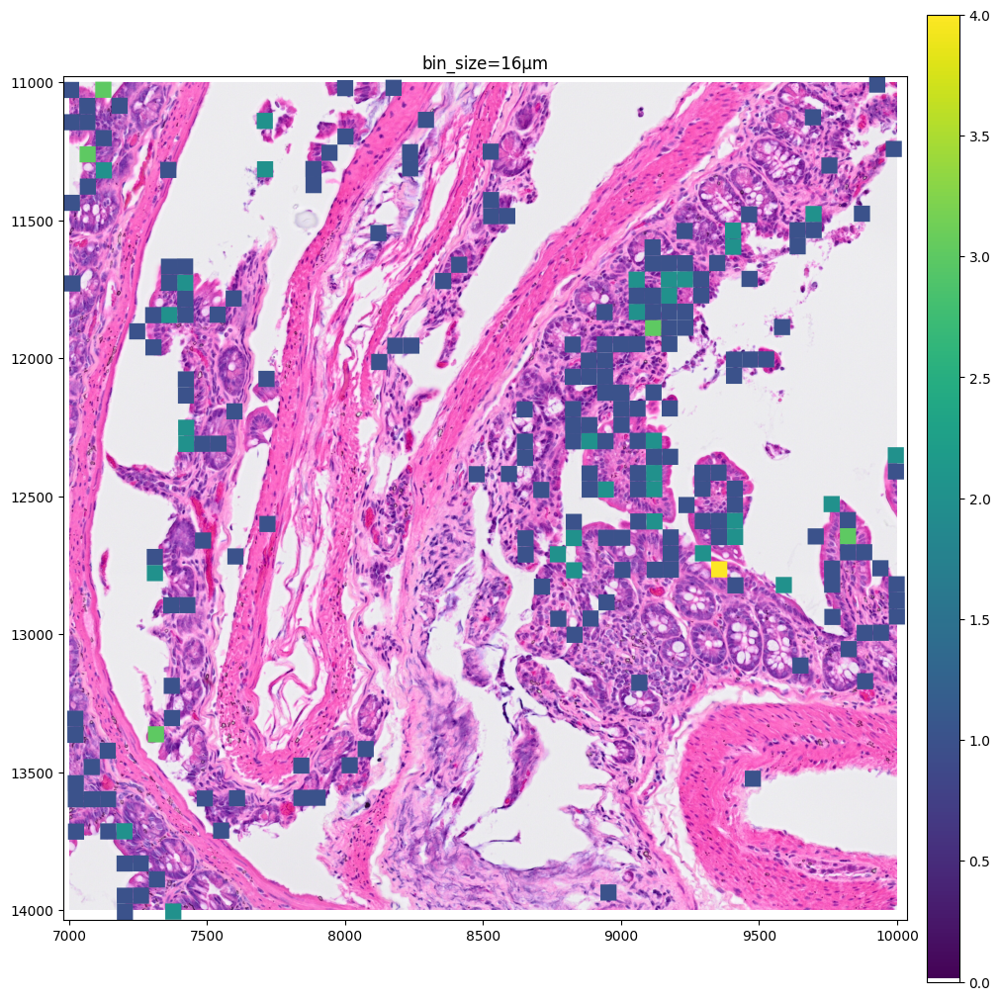

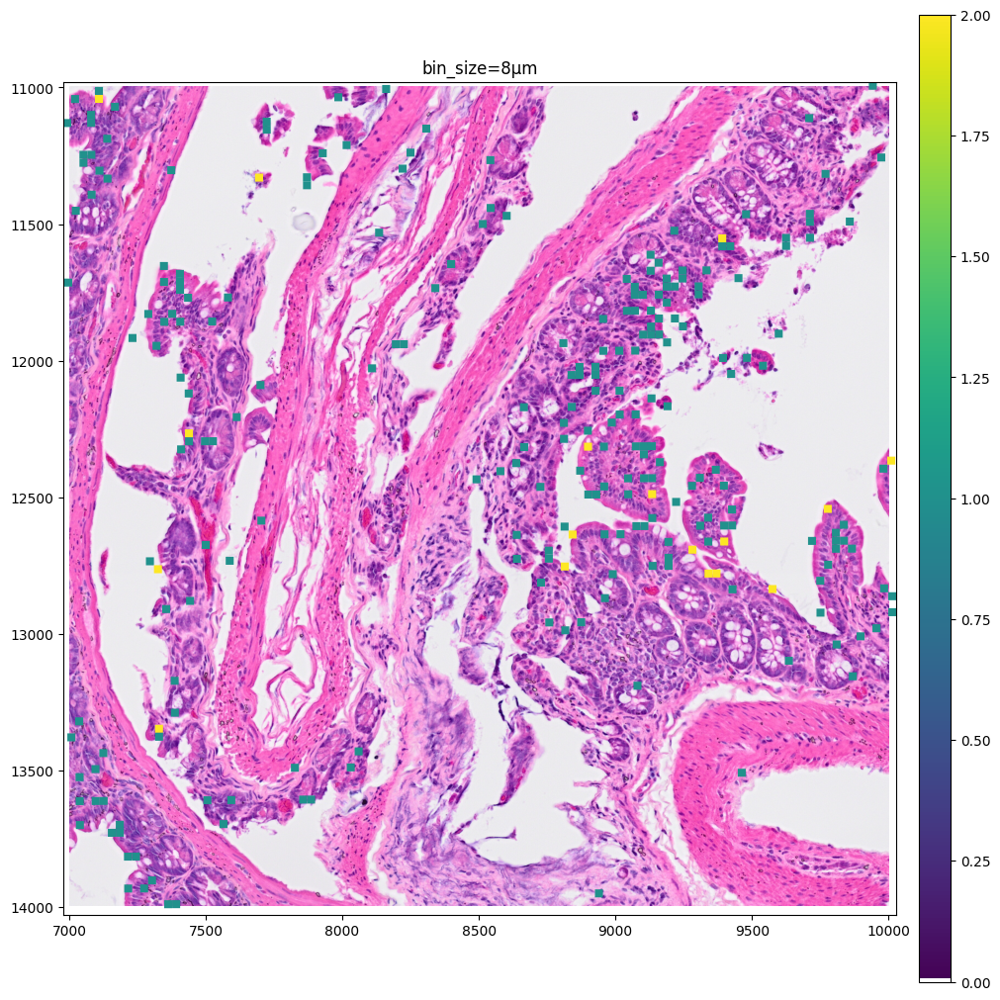

In [27]:
gene_name = "AA986860"

for bin_size in [16, 8]:
    sdata_small.pl.render_images("Visium_HD_Mouse_Small_Intestine_full_image").pl.render_shapes(
        f"Visium_HD_Mouse_Small_Intestine_square_{bin_size:03}um", color=gene_name, cmap=new_cmap
    ).pl.show(coordinate_systems="global", title=f"bin_size={bin_size}µm", figsize=(10, 10))

Let’s make a zoomed version of the plot for the 2µm bins to better visualize them. Please notice that we pass method='matplotlib' as currently this is required in order to visualize the background as transparent by means of the modified colormap.

In [29]:
from spatialdata import bounding_box_query

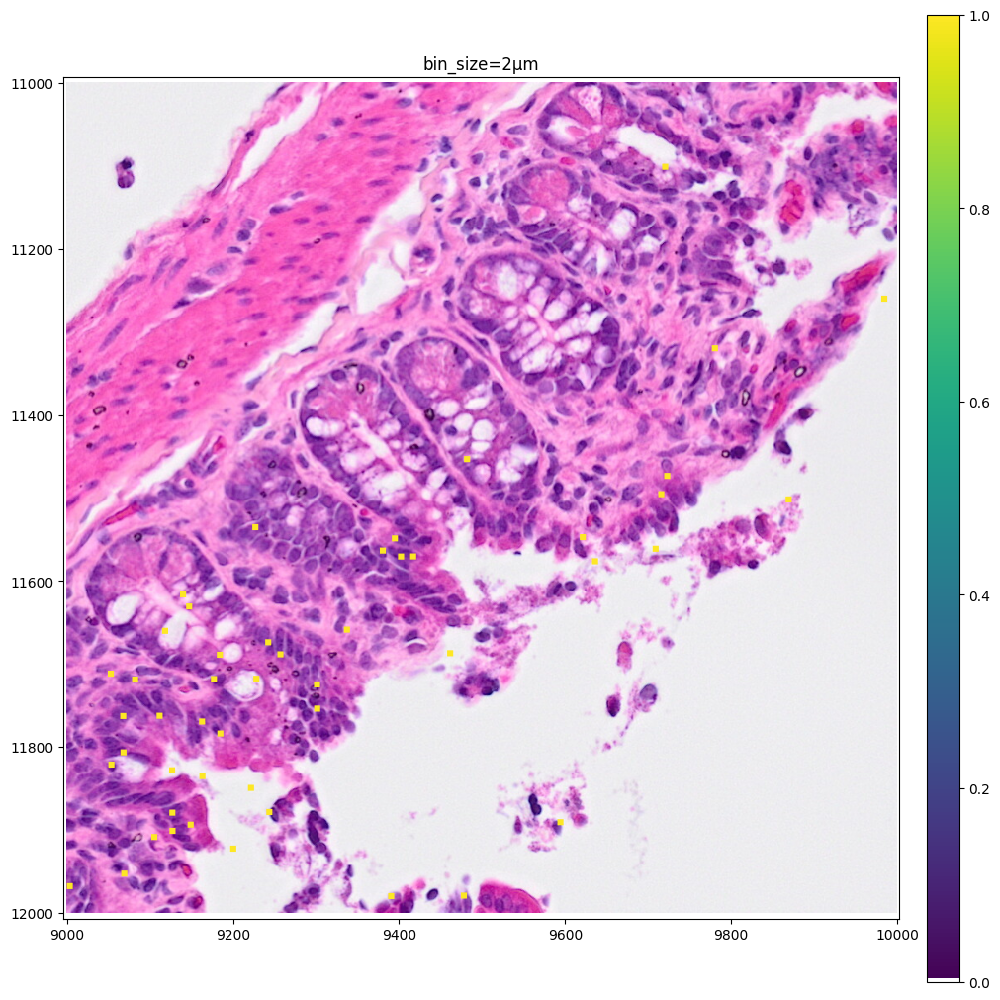

In [30]:
crop1 = lambda x: bounding_box_query(
    x, min_coordinate=[9000, 11000], max_coordinate=[10000, 12000], axes=("x", "y"), target_coordinate_system="global"
)
crop1(sdata_small).pl.render_images("Visium_HD_Mouse_Small_Intestine_full_image").pl.render_shapes(
    "Visium_HD_Mouse_Small_Intestine_square_002um", color=gene_name, cmap=new_cmap, method="matplotlib"
).pl.show(coordinate_systems="global", title=f"bin_size=2µm", figsize=(10, 10))

As you can see the 8µm bins are convenient for looking at gene expression distribution from a broad perspective (same for the 16µm bins, where some resolution can be sacrificed in exchange for a faster visualization). On the other hand, the 2µm bins allow to precisely locate the expressed genes in the tissue.

### Plotting clusters

Let’s now color the 16µm bins by cluster identity. Let’s reuse the clusters gene_expression_graphclust computed from 10x Genomics and available with the raw data from the 10x Genomics website.

In [31]:
import os
from tempfile import TemporaryDirectory

import pandas as pd
import requests

# For convenience we rehost the single file containing the clusters we are interested in.
# Let's download it in a temporary directory and read it in a pandas DataFrame. The file is 2 MB.
clusters_file_url = "https://s3.embl.de/spatialdata/misc/visium_hd_mouse_intestine_16um_graphclust.csv"

with TemporaryDirectory() as tmpdir:
    path = os.path.join(tmpdir, "data.csv")
    response = requests.get(clusters_file_url)
    with open(path, "wb") as f:
        f.write(response.content)
    df = pd.read_csv(path)

In [32]:
df.head(3)

,Barcode,Cluster
0,s_016um_00144_00175-1,3
1,s_016um_00145_00029-1,7
2,s_016um_00165_00109-1,8


In [33]:
# let's convert the Cluster dtype from int64 to categorical since later we want the plots to use a categorical colormap
df["Cluster"] = df["Cluster"].astype("category")
df.set_index("Barcode", inplace=True)

Let’s merge the data.

In [34]:
sdata_visium_hd["square_016um"].obs["Cluster"] = df["Cluster"]

Let’s plot the clusters on one of the data crops we used before.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.25757575..1.0].


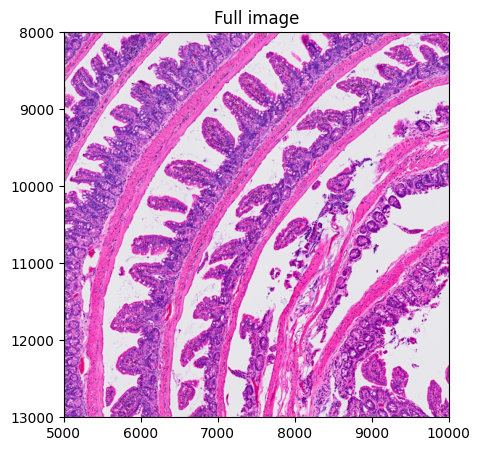

In [43]:
fig, ax = plt.subplots(1, 1, figsize=(10, 5))  # Create a single axis
crop0 = lambda x: bounding_box_query(
    x, min_coordinate=[5000, 8000], max_coordinate=[10000, 13000], axes=("x", "y"), target_coordinate_system="global"
)
crop0(sdata_visium_hd).pl.render_images("Visium_HD_Mouse_Small_Intestine_full_image").pl.show(
    ax=ax, title="Full image", coordinate_systems="global"
)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.123893805..1.0].
/Users/georgegavriilidis/spatialdata_env/lib/python3.9/site-packages/spatialdata_plot/pl/utils.py:778: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = color_source_vector.map(color_mapping)


CPU times: user 3.94 s, sys: 386 ms, total: 4.33 s
Wall time: 2.89 s


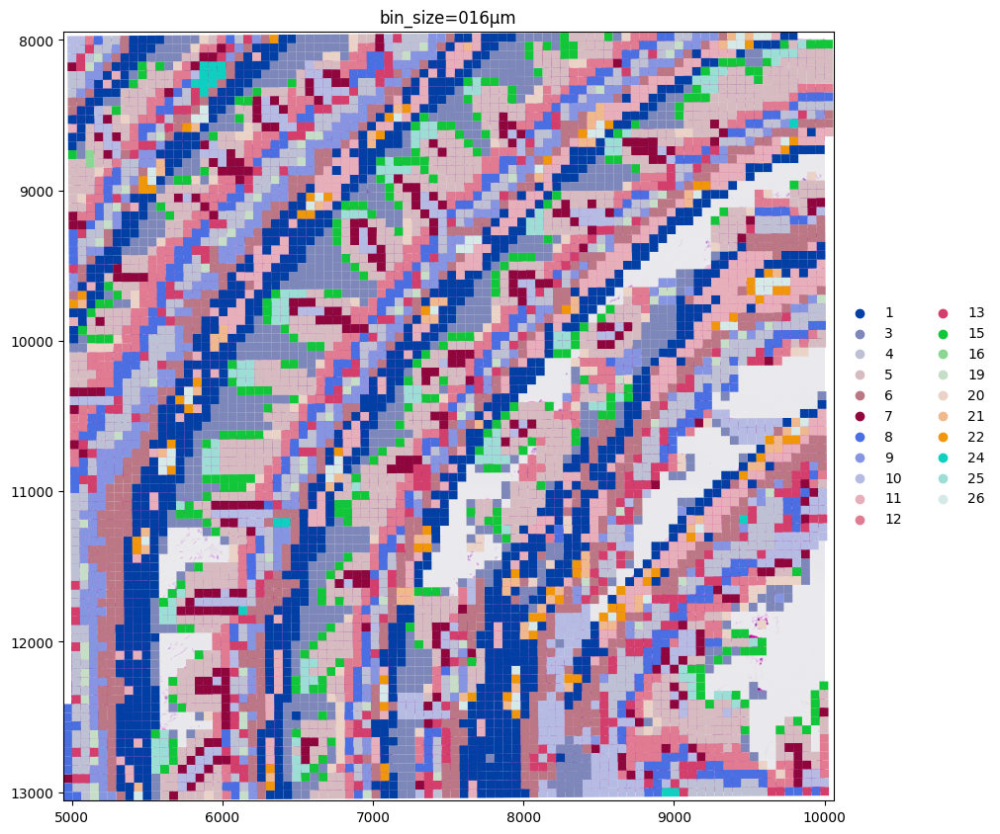

In [37]:
%%time
crop0(sdata_visium_hd).pl.render_images("Visium_HD_Mouse_Small_Intestine_full_image").pl.render_shapes(
    "Visium_HD_Mouse_Small_Intestine_square_016um", color="Cluster"
).pl.show(coordinate_systems="global", title=f"bin_size=016µm", figsize=(10, 10))